Pair Programming Random Forest - 12

In [25]:
# Tratamiento de datos
# ------------------------------------------------------------------------------
import numpy as np
import pandas as pd

# Gráficos
# ------------------------------------------------------------------------------
import matplotlib.pyplot as plt
import seaborn as sns

# Modelado y evaluación
# ------------------------------------------------------------------------------
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn import tree
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
from sklearn.model_selection import GridSearchCV

# Barra de progreso de un proceso
# ------------------------------------------------------------------------------
from tqdm import tqdm

# Configuración warnings
# ------------------------------------------------------------------------------
import warnings
warnings.filterwarnings('once')



En el pair programming de hoy debéis usar el csv que guardastéis cuando hicistéis el pairprgramming de codificicación (este csv debería tener las variables estadandarizas).
En pairprogramming anteriores ajustastéis vuestro datos a una regresión lineal y a un Decision Tree. El objetivo de hoy es:
 - Ajustar el modelo a un Random Forest
 - Extraer las métricas
 - Debatid entre vosotras que modelo es mejor y por qué (basándose en las métricas)

In [7]:
df = pd.read_csv('/wellness_8.csv', index_col = 0)

In [13]:
df12 = df.copy()

In [14]:
df12.drop(['GENDER', 'WORK_LIFE_BALANCE_SCORE'], axis = 1, inplace = True)

In [15]:
df12.sample(3)

,FRUITS_VEGGIES,DAILY_STRESS,CORE_CIRCLE,SOCIAL_NETWORK,BMI_RANGE,DAILY_STEPS,SLEEP_HOURS,SUFFICIENT_INCOME,TIME_FOR_PASSION,WEEKLY_MEDITATION,AGE,WORK_LIFE_BALANCE_SCORE_RAIZ,AGE_le,owners_Female,owners_Male
5640,3,3,3,5,2,5,8,2,5,6,2,25.438160,1,1,0
12039,2,1,10,8,1,7,7,2,10,7,1,26.425367,0,1,0
12619,2,3,7,3,1,4,6,2,10,7,2,26.602631,1,1,0


# Preparamos los datos

In [16]:
# al igual que en la regresión lineal, separamos nuestro dataframe en X e y

X = df12.drop('WORK_LIFE_BALANCE_SCORE_RAIZ', axis = 1)
y = df12['WORK_LIFE_BALANCE_SCORE_RAIZ']

In [17]:
# dividimos nuestros datos en train y test para poder evaluar la bondad de nuestro modelo

x_train, x_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 42)

# Ajustamos el modelo

Del pair anterior (Decision Tree) traemos los valores de max_depth y max_features

In [26]:
# creamos el objeto del modelo, al igual que hacíamos en la regresión lineal
arbol = DecisionTreeRegressor(random_state =0)

# ajustamos el modelo, igual que en la regresión lienal. 
arbol.fit(x_train, y_train)


DecisionTreeRegressor(random_state=0)

In [27]:
max_features = np.sqrt(len(x_train.columns))
max_features

3.7416573867739413

In [29]:
print(arbol.tree_.max_depth)

25


In [32]:
# creamos un diccionario con los hiperparámetros que queremos probar

param = {"max_depth": [2, 4, 6, 8, 10], # teniendo en cuenta que teníamos overfitting tendremos que reducir la profundidad del modelo, la nuestra es 25.
        "max_features": [1,2,3,4],# Probaremos a hacer el modelo como una variable, 2, 3 y 4. Ponemos como límite el 4 ya que es el resultado de la raiz cuadrada(3.7). 
        # 
        "min_samples_split": [50,100,150, 200, 300, 400, 500],
        "min_samples_leaf": [50,100,150, 200, 300, 400, 500]} 

In [33]:
gs_rf = GridSearchCV(
            estimator=RandomForestRegressor(), # tipo de modelo que queremos hacer
            param_grid= param, # que hiperparámetros queremos que testee
            cv=10, # crossvalidation que aprendimos en la lección de regresión lineal intro. 
            verbose=-1, # para que no nos printee ningún mensaje en pantalla
            return_train_score = True, # para que nos devuelva el valor de las métricas de set de datos de entrenamiento
            scoring="neg_mean_squared_error") # la métrica que queremos que nos devuelva

In [36]:


# ajustamos el modelo que acabamos de definir en el GridSearch
# 🚨 Esta celda puede tardar en ejecutarse

gs_rf.fit(x_train, y_train)

GridSearchCV(cv=10, estimator=RandomForestRegressor(),
             param_grid={'max_depth': [2, 4, 6, 8, 10],
                         'max_features': [1, 2, 3, 4],
                         'min_samples_leaf': [50, 100, 150, 200, 300, 400, 500],
                         'min_samples_split': [50, 100, 150, 200, 300, 400,
                                               500]},
             return_train_score=True, scoring='neg_mean_squared_error',
             verbose=-1)

In [37]:
# para saber cual será nuetrao mejor bosque: formado por arboles de 10 de profundidad,
# 4 variables y que tiene  un min_samples_leaf de 50 y un min_samples_split de 100. 

bosque = gs_rf.best_estimator_
bosque

RandomForestRegressor(max_depth=10, max_features=4, min_samples_leaf=50,
                      min_samples_split=50)

  0%|          | 0/100 [00:00<?, ?it/s]

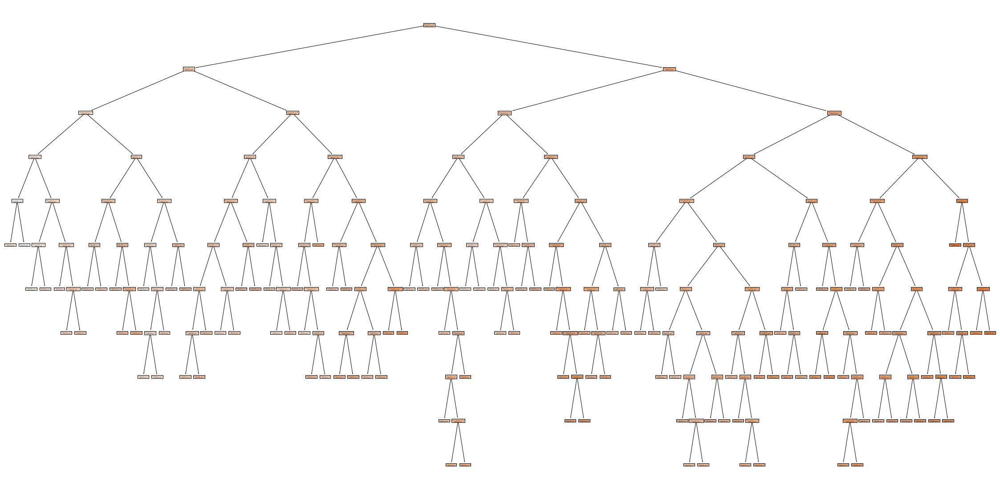

  1%|          | 1/100 [00:06<09:55,  6.02s/it]

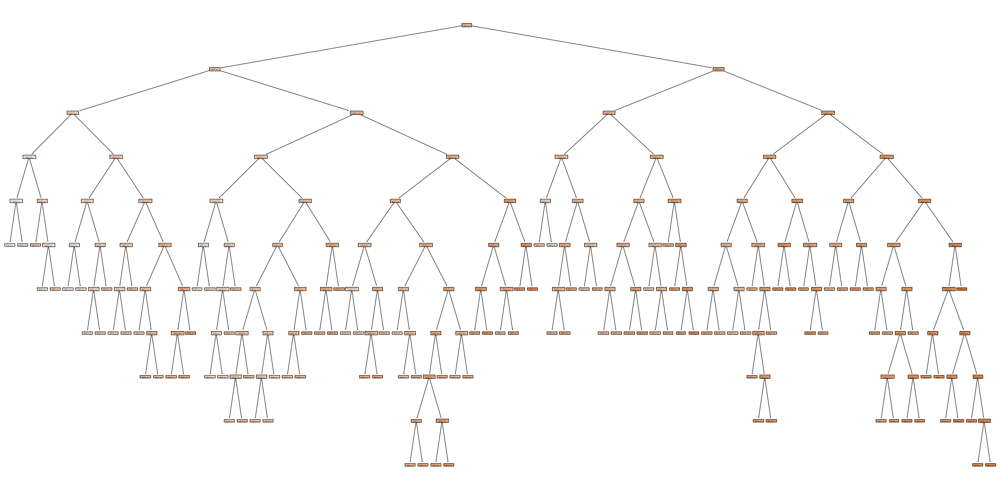

  2%|▏         | 2/100 [00:11<09:47,  5.99s/it]

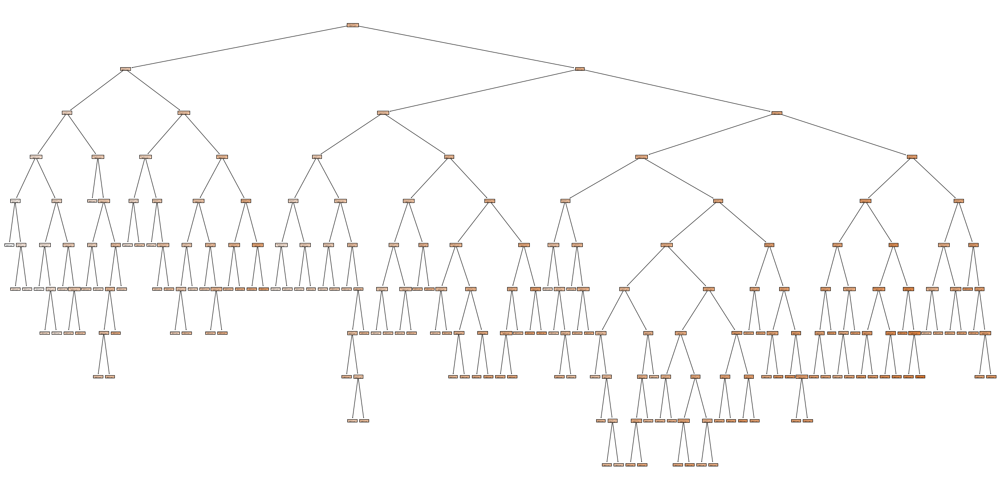

  3%|▎         | 3/100 [00:18<09:44,  6.03s/it]

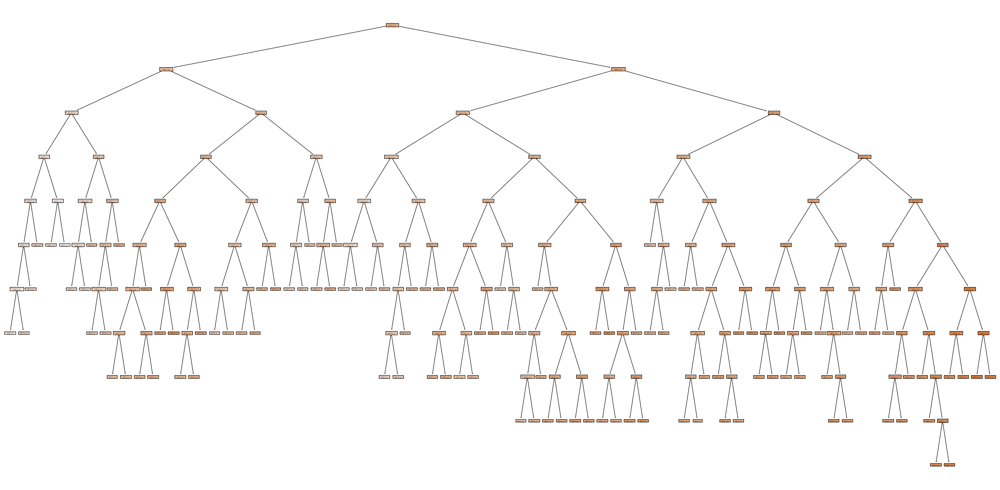

  4%|▍         | 4/100 [00:24<09:35,  6.00s/it]

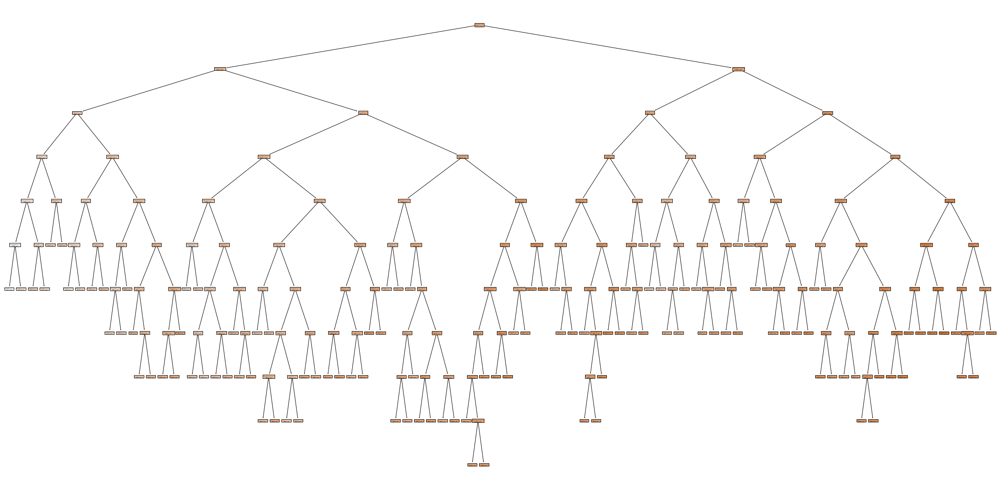

  5%|▌         | 5/100 [00:30<09:35,  6.06s/it]

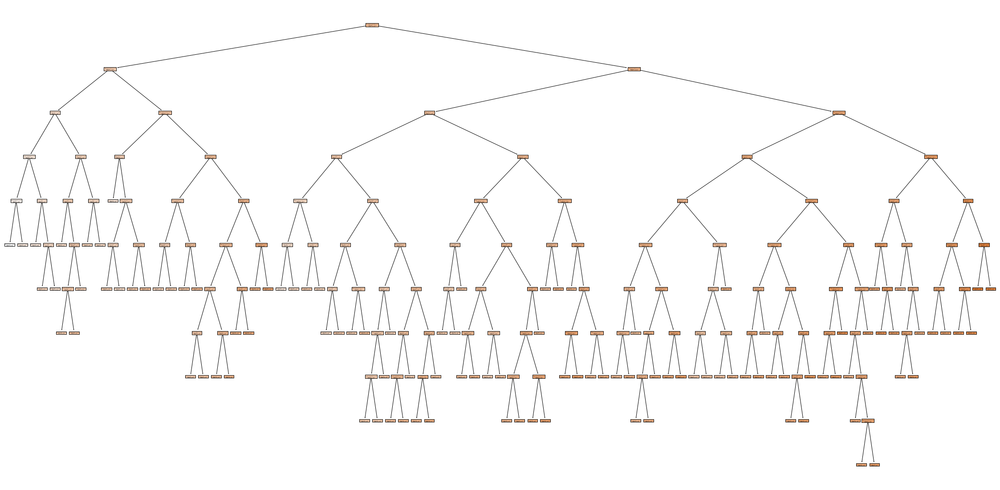

  6%|▌         | 6/100 [00:35<09:20,  5.97s/it]

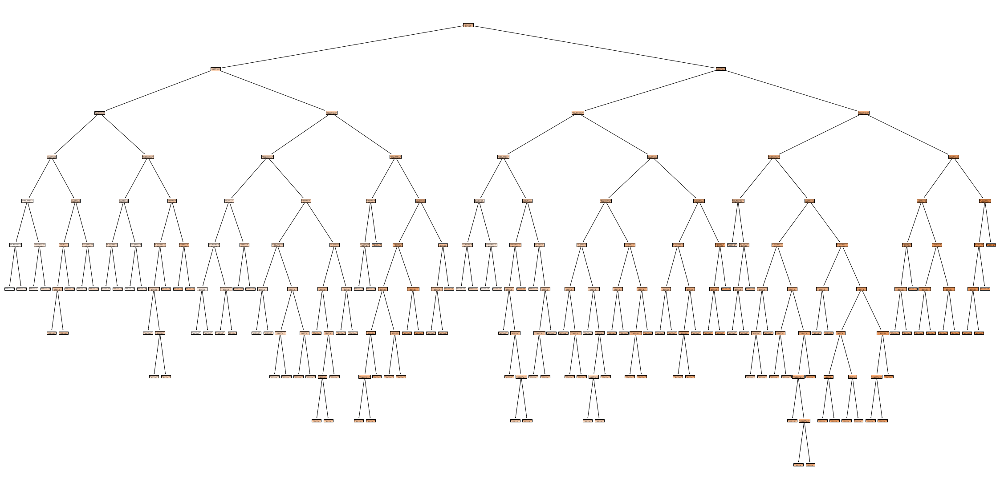

  7%|▋         | 7/100 [00:42<09:27,  6.10s/it]

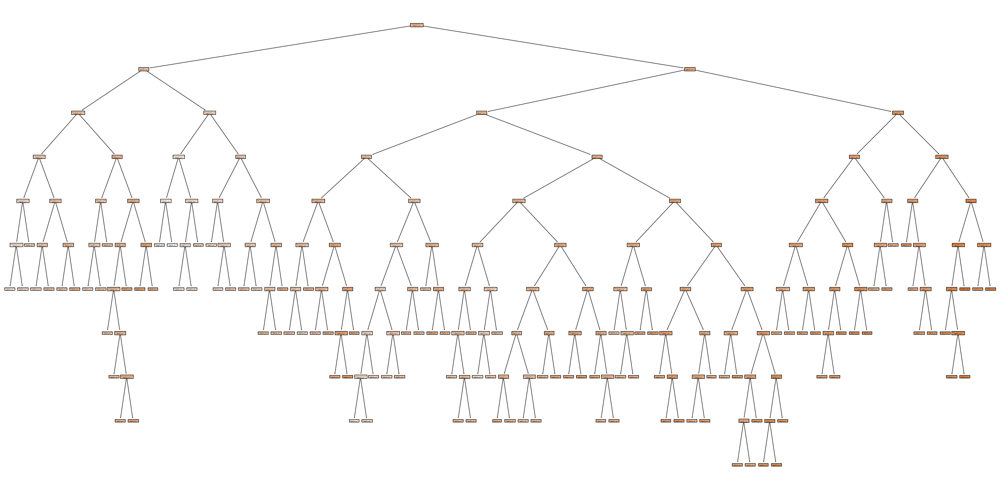

  8%|▊         | 8/100 [00:48<09:12,  6.01s/it]

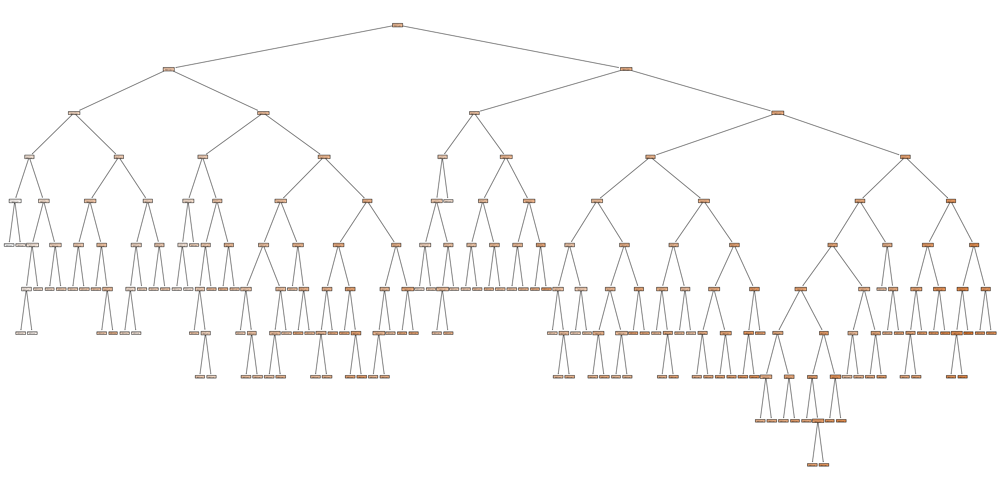

  9%|▉         | 9/100 [00:54<09:03,  5.97s/it]

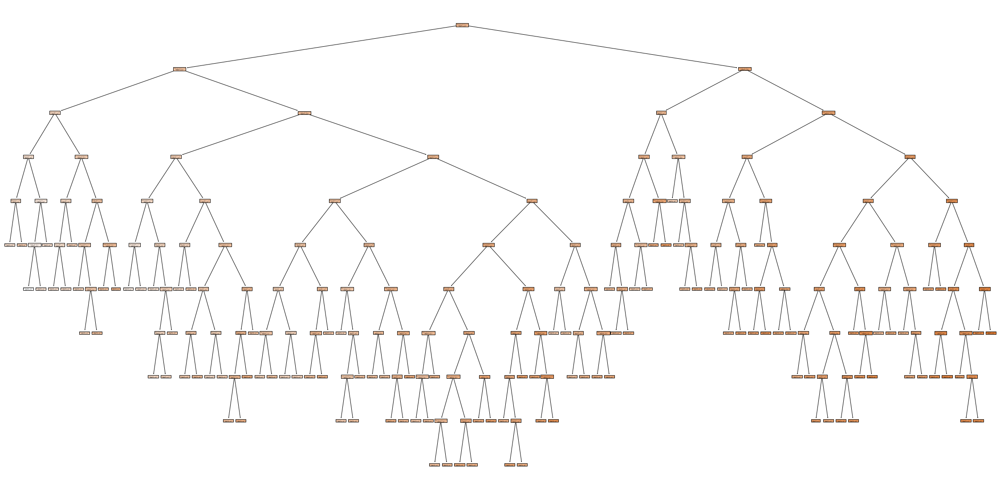

 10%|█         | 10/100 [01:00<08:58,  5.98s/it]

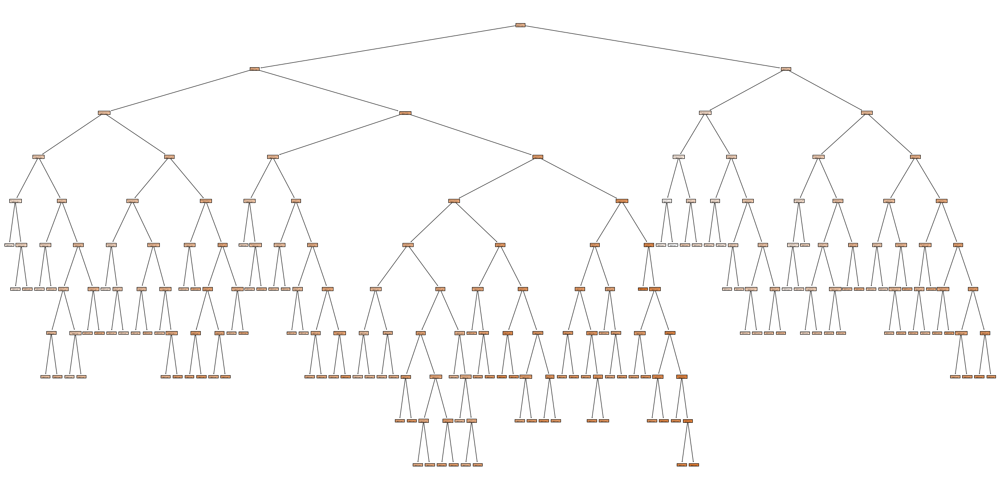

 11%|█         | 11/100 [01:06<08:52,  5.98s/it]

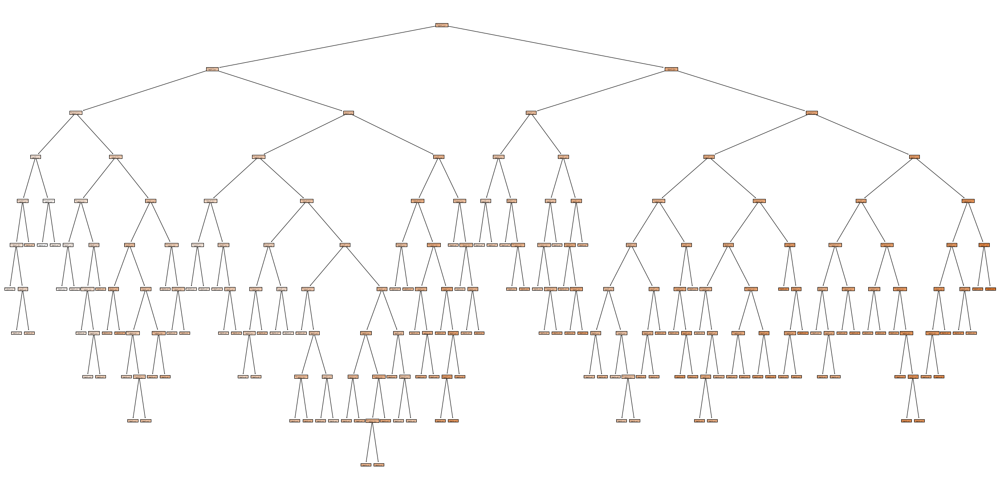

 12%|█▏        | 12/100 [01:12<08:52,  6.05s/it]

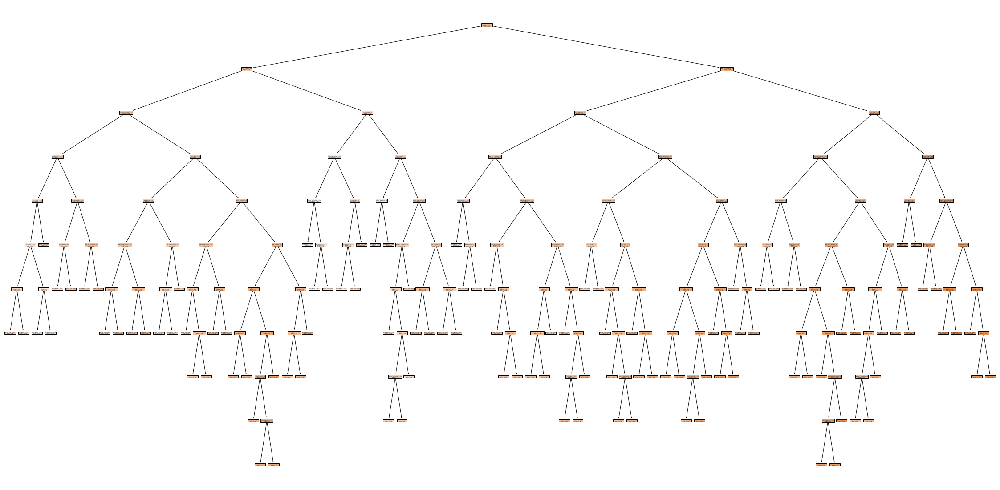

 13%|█▎        | 13/100 [01:18<08:42,  6.00s/it]

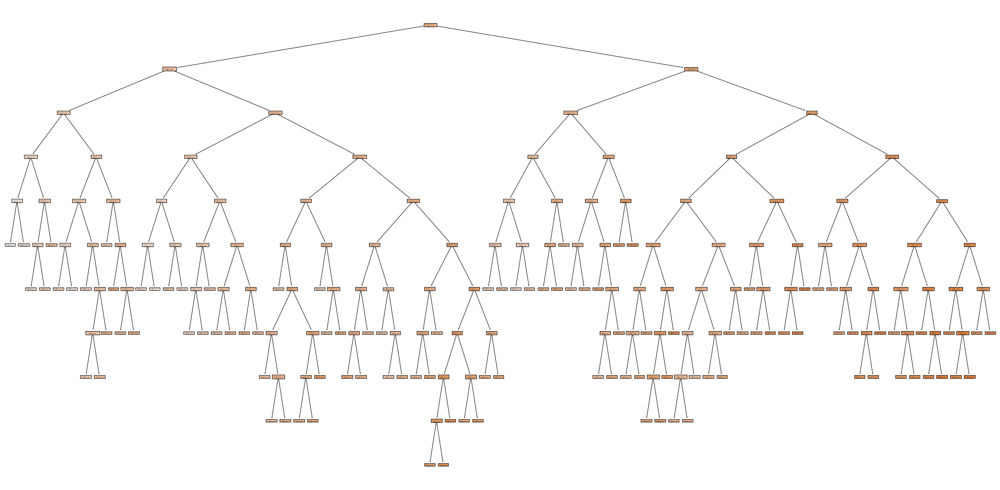

 14%|█▍        | 14/100 [01:23<08:28,  5.92s/it]

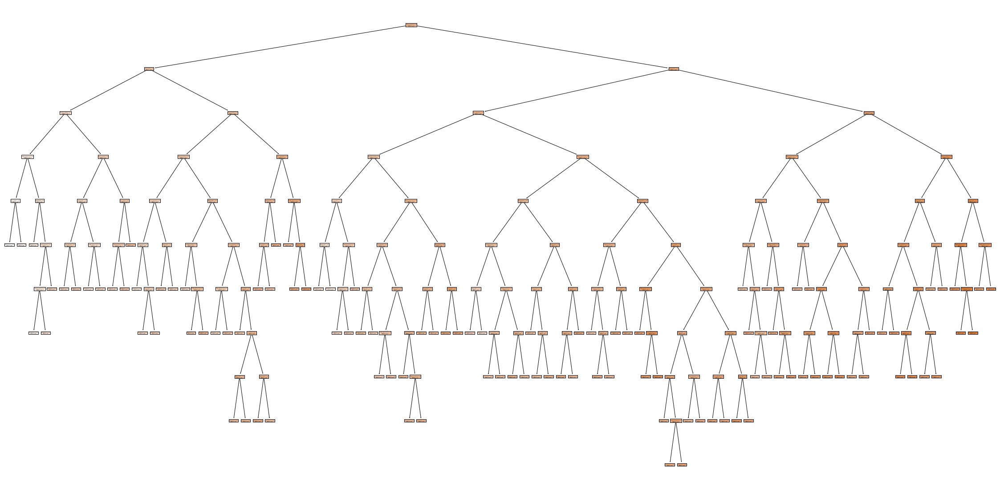

 15%|█▌        | 15/100 [01:29<08:21,  5.90s/it]

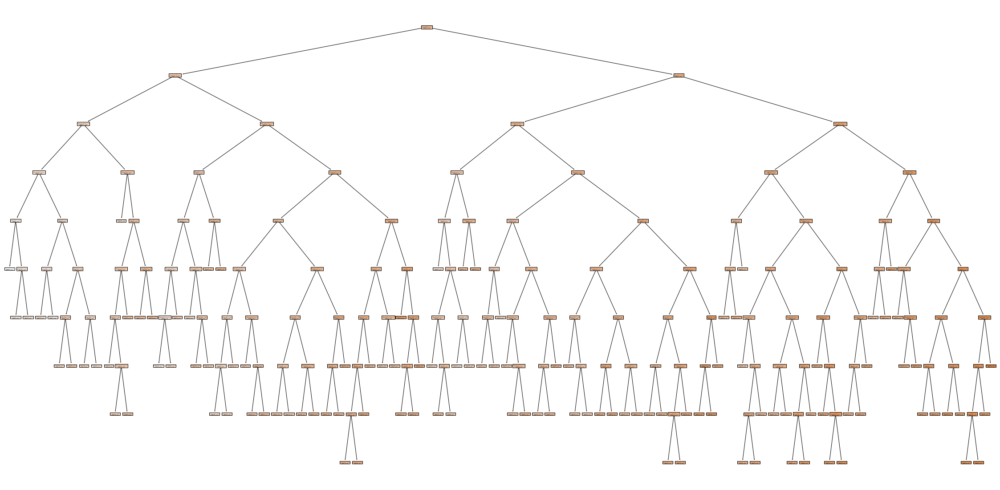

 16%|█▌        | 16/100 [01:35<08:20,  5.96s/it]

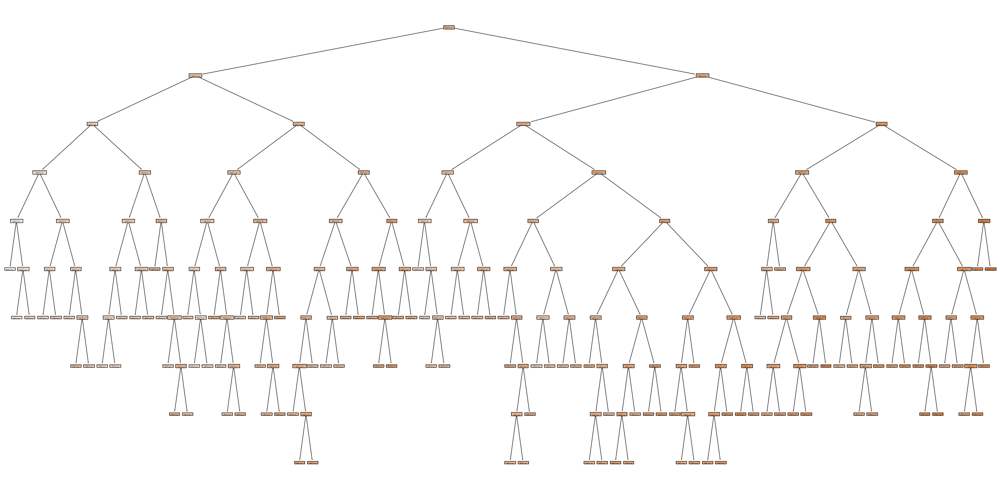

 17%|█▋        | 17/100 [01:41<08:11,  5.92s/it]

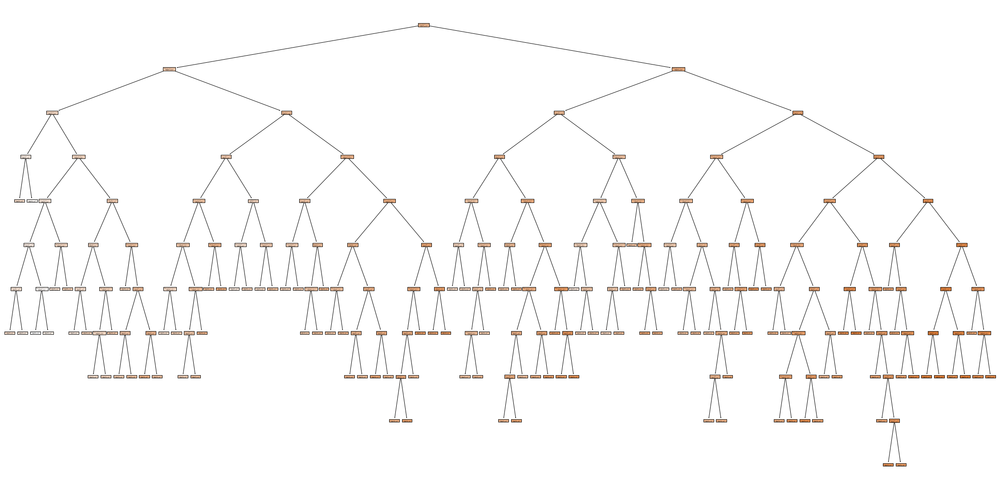

 18%|█▊        | 18/100 [01:47<08:07,  5.95s/it]

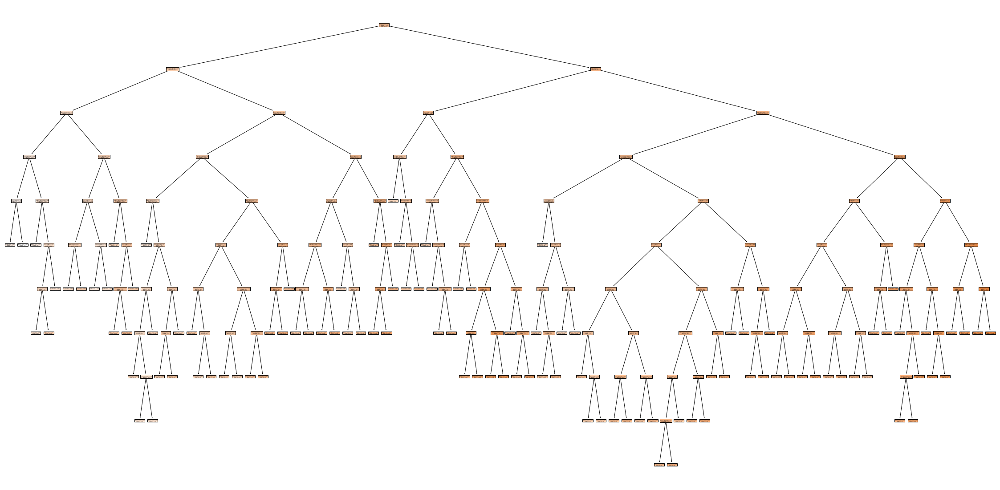

 19%|█▉        | 19/100 [01:53<07:57,  5.89s/it]

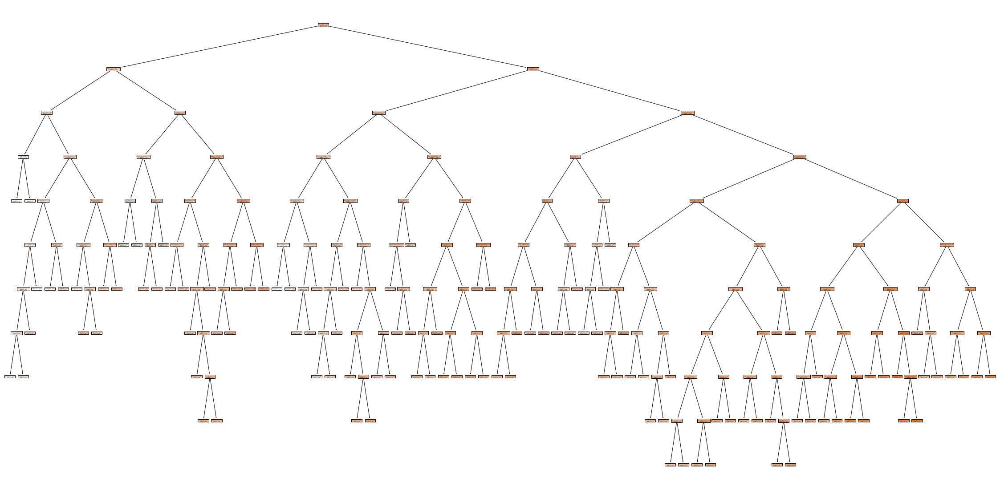

 20%|██        | 20/100 [01:59<07:53,  5.92s/it]

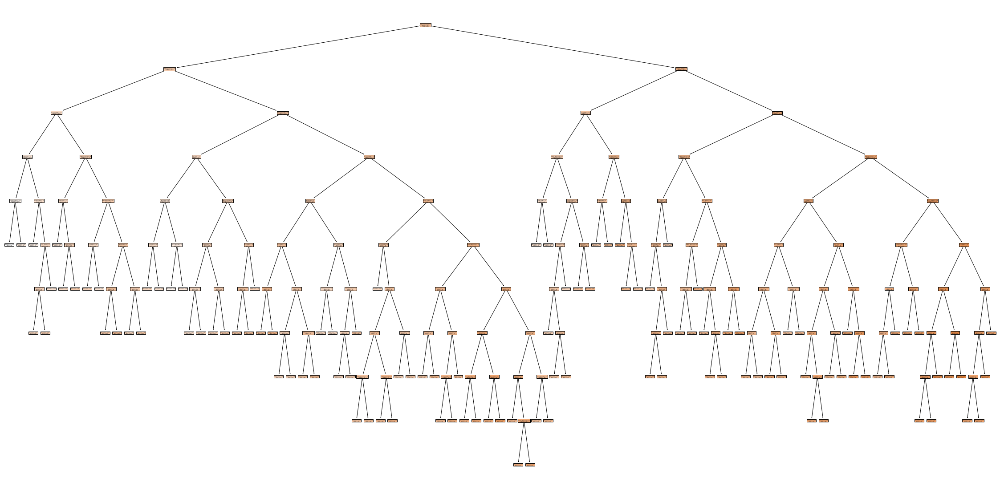

 21%|██        | 21/100 [02:05<07:51,  5.97s/it]

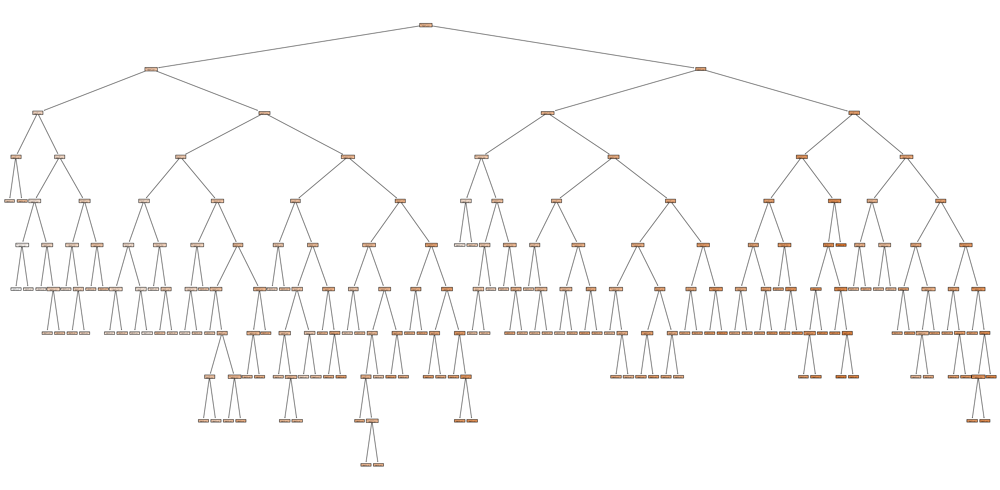

 22%|██▏       | 22/100 [02:11<07:48,  6.01s/it]

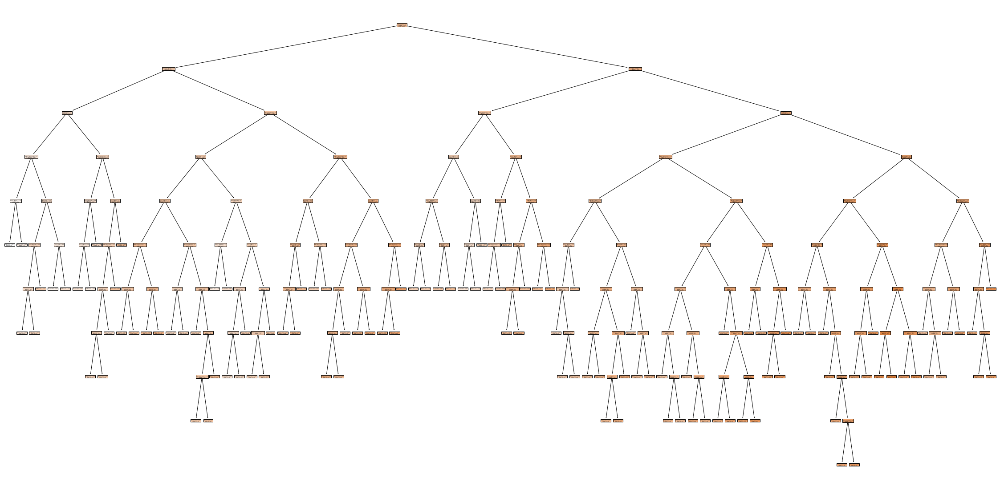

 23%|██▎       | 23/100 [02:17<07:45,  6.04s/it]

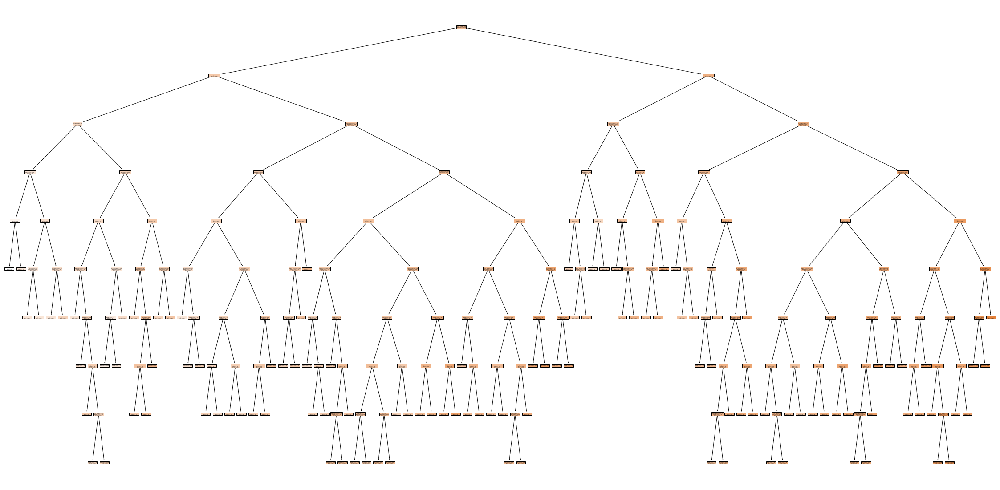

 24%|██▍       | 24/100 [02:23<07:40,  6.06s/it]

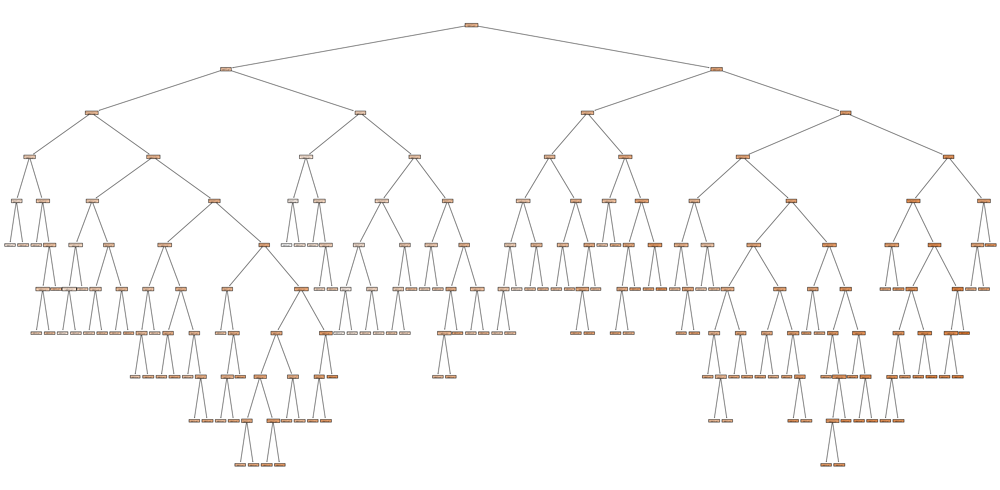

 25%|██▌       | 25/100 [02:29<07:30,  6.00s/it]

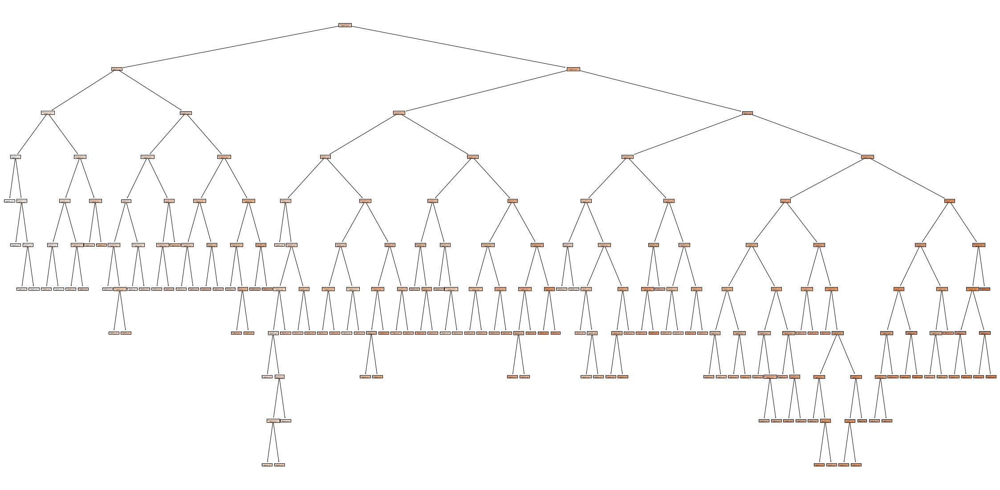

 26%|██▌       | 26/100 [02:35<07:19,  5.94s/it]

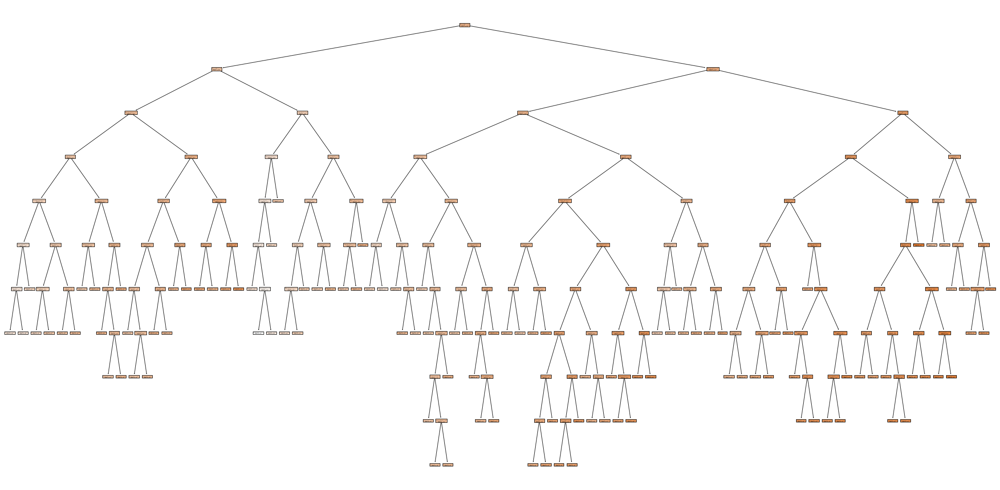

 27%|██▋       | 27/100 [02:41<07:16,  5.98s/it]

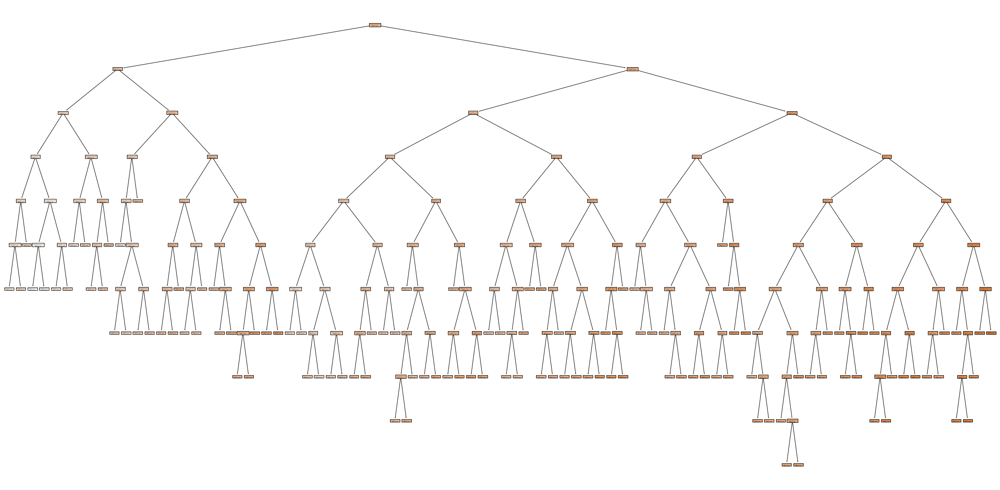

 28%|██▊       | 28/100 [02:47<07:16,  6.06s/it]

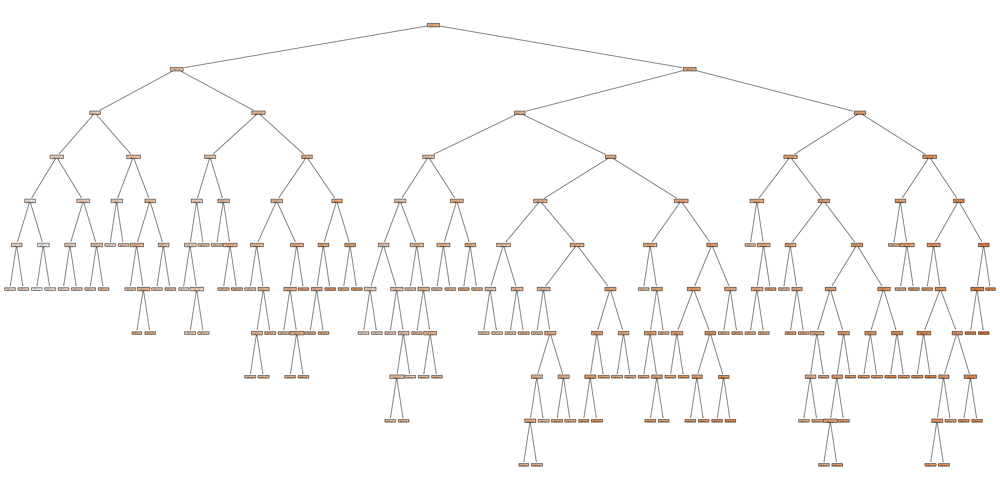

 29%|██▉       | 29/100 [02:53<07:08,  6.03s/it]

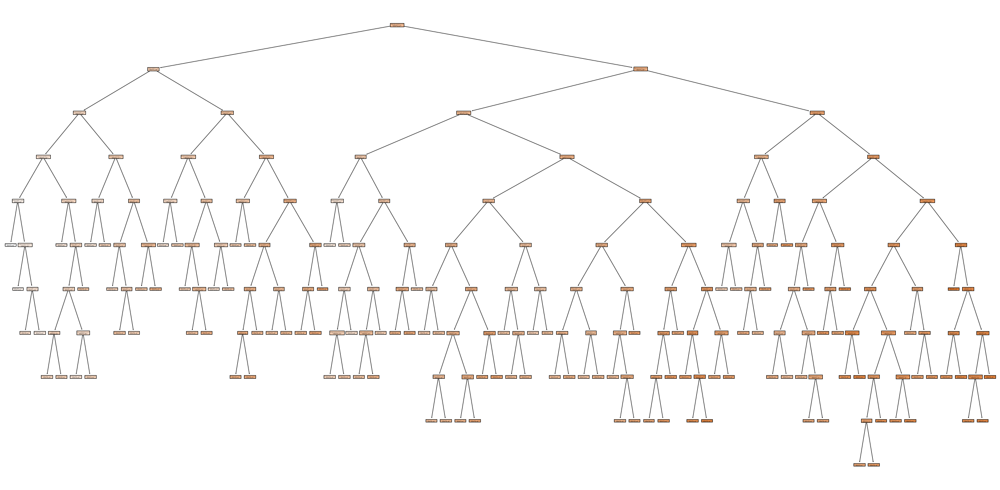

 30%|███       | 30/100 [02:59<06:56,  5.95s/it]

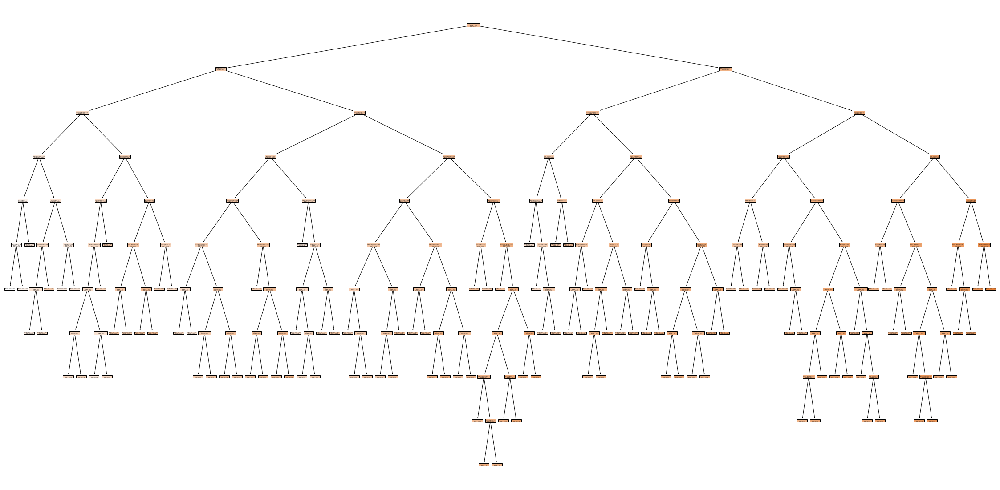

 31%|███       | 31/100 [03:05<06:56,  6.03s/it]

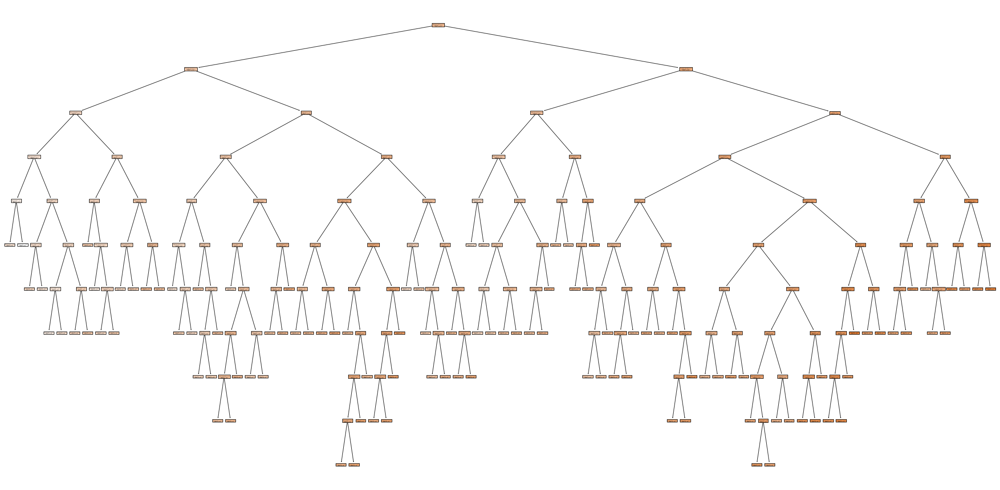

 32%|███▏      | 32/100 [03:11<06:46,  5.98s/it]

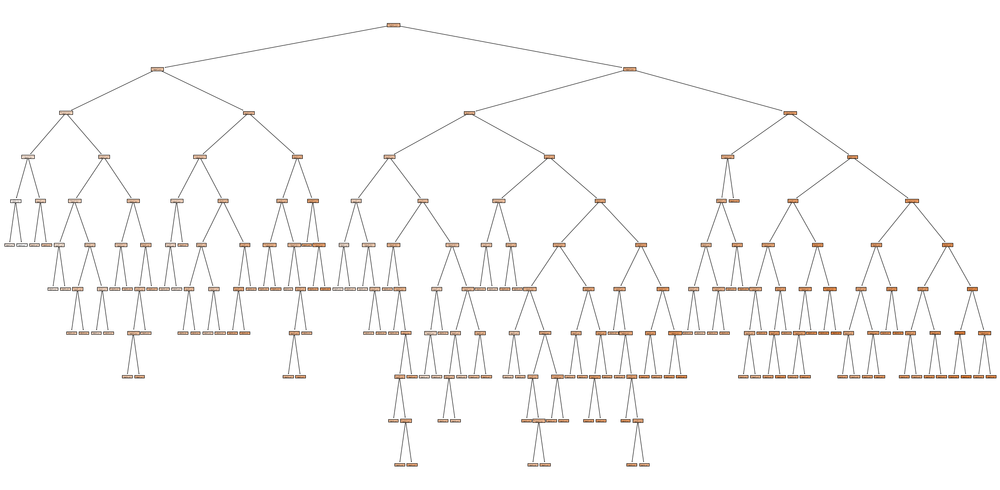

 33%|███▎      | 33/100 [03:17<06:41,  6.00s/it]

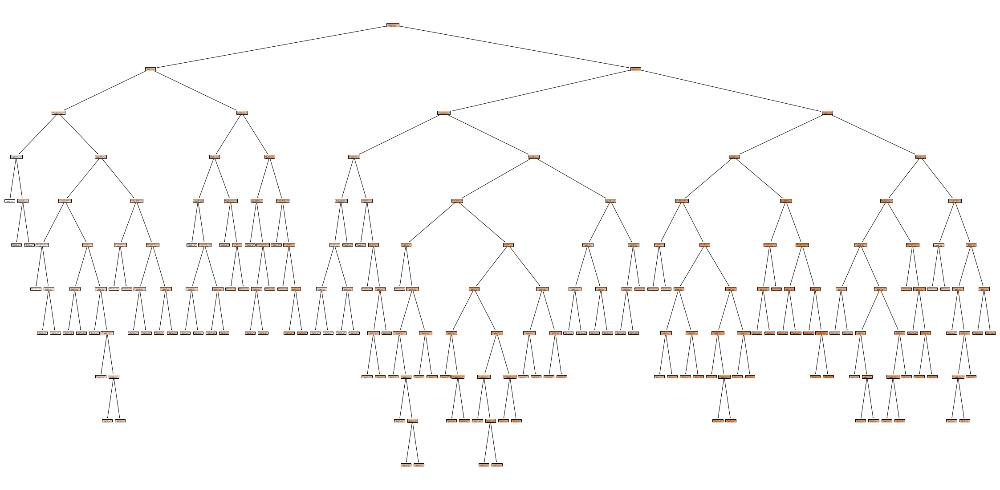

 34%|███▍      | 34/100 [03:23<06:34,  5.98s/it]

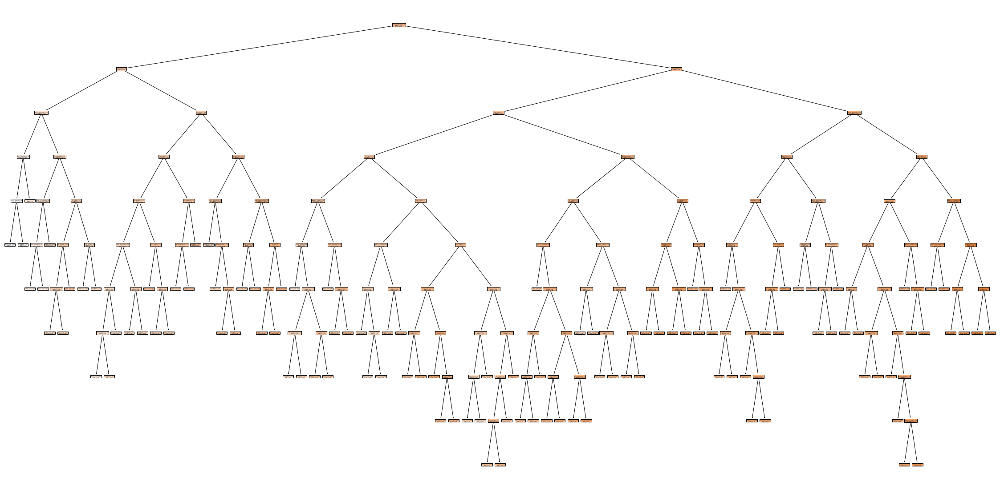

 35%|███▌      | 35/100 [03:29<06:26,  5.95s/it]

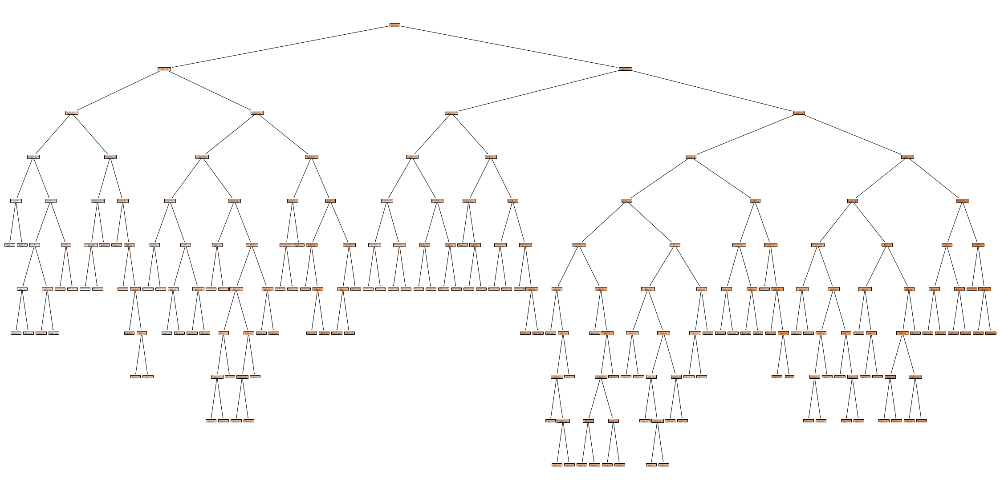

 36%|███▌      | 36/100 [03:35<06:24,  6.00s/it]

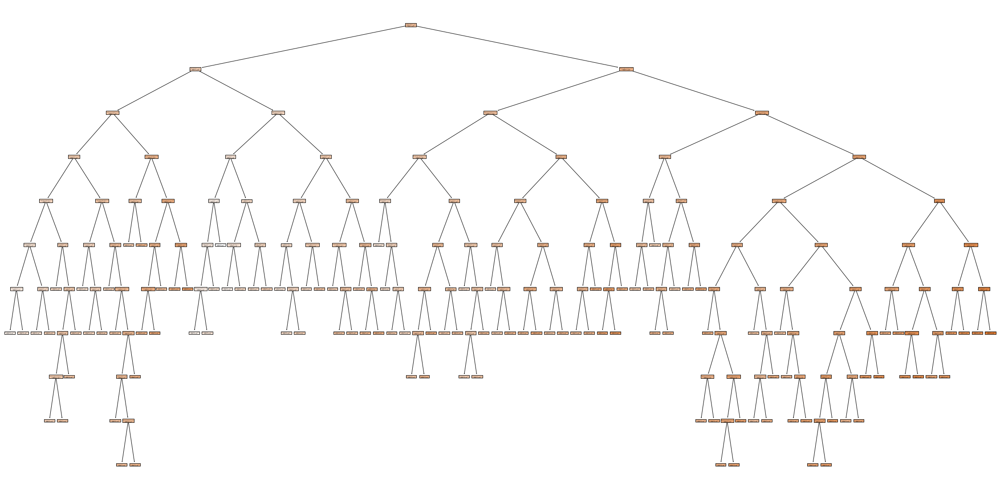

 37%|███▋      | 37/100 [03:41<06:17,  5.99s/it]

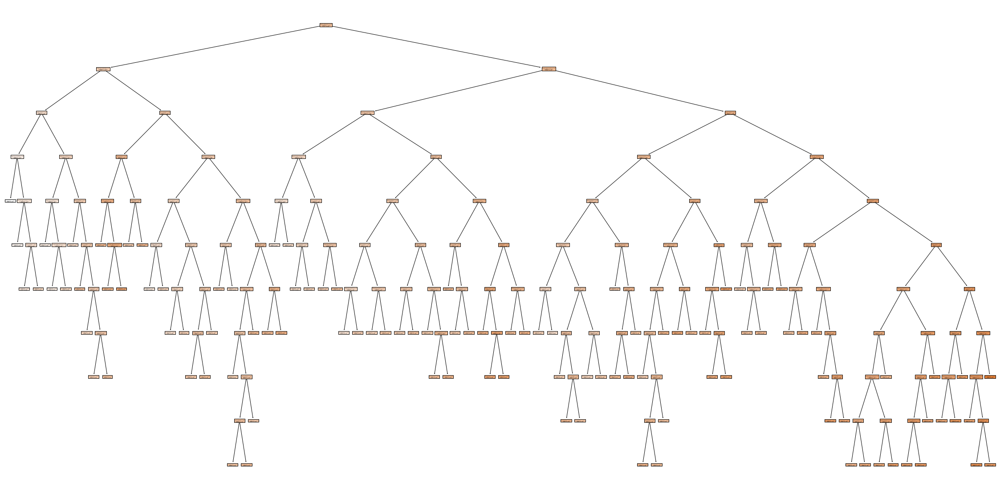

 38%|███▊      | 38/100 [03:47<06:07,  5.92s/it]

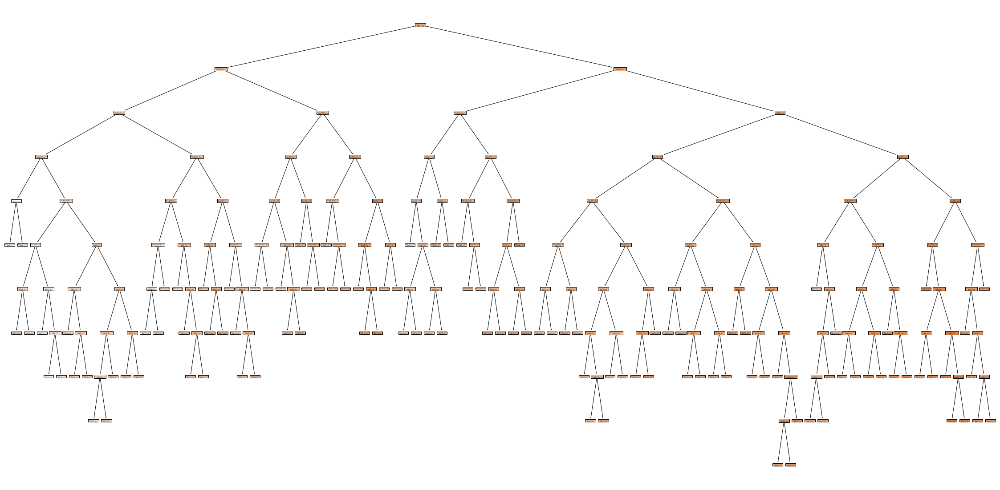

 39%|███▉      | 39/100 [03:53<06:02,  5.95s/it]

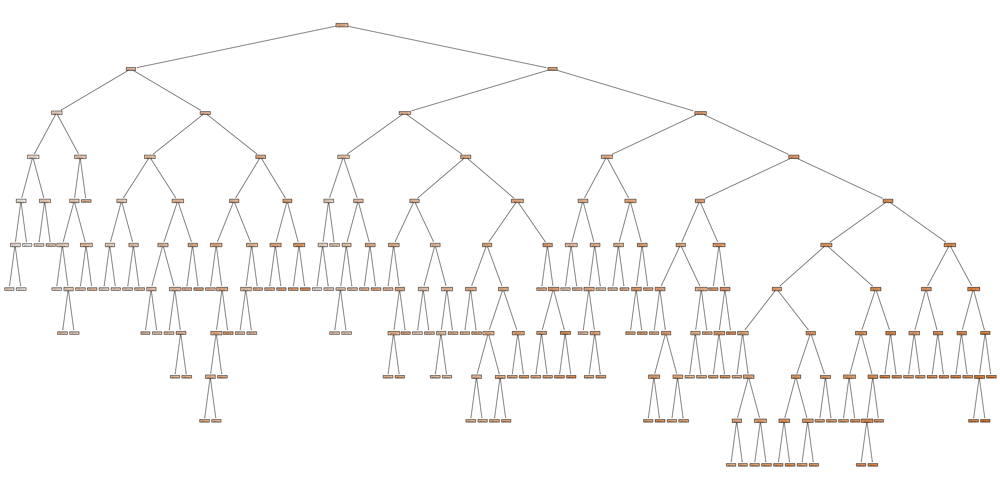

 40%|████      | 40/100 [03:59<06:01,  6.03s/it]

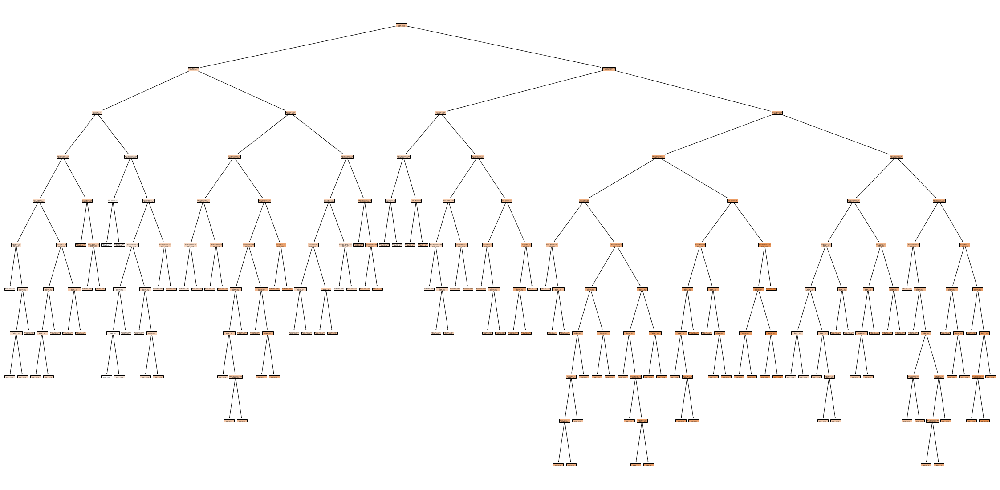

 41%|████      | 41/100 [04:05<05:59,  6.10s/it]

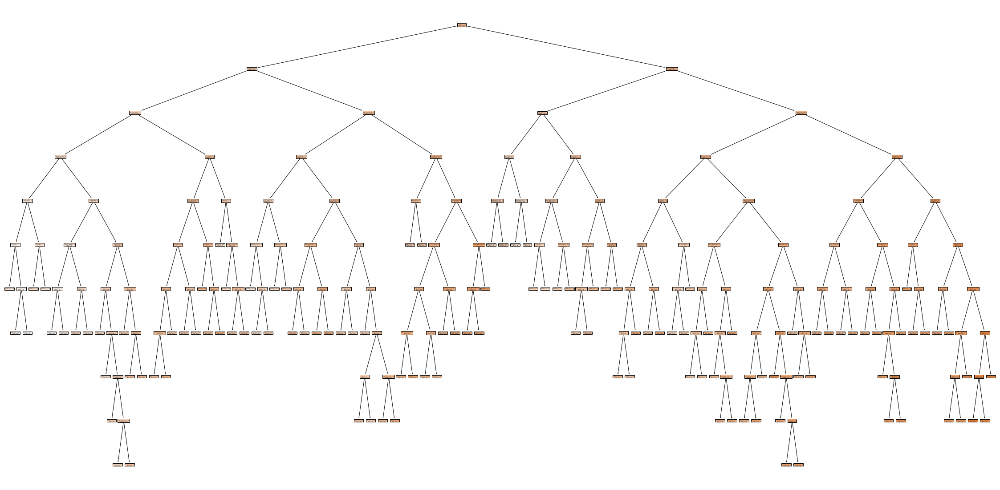

 42%|████▏     | 42/100 [04:12<05:56,  6.15s/it]

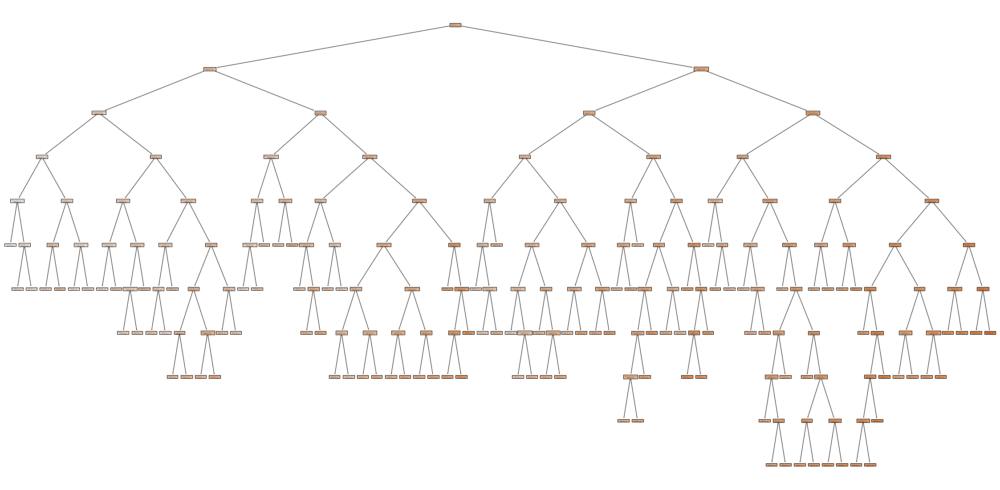

 43%|████▎     | 43/100 [04:17<05:43,  6.02s/it]

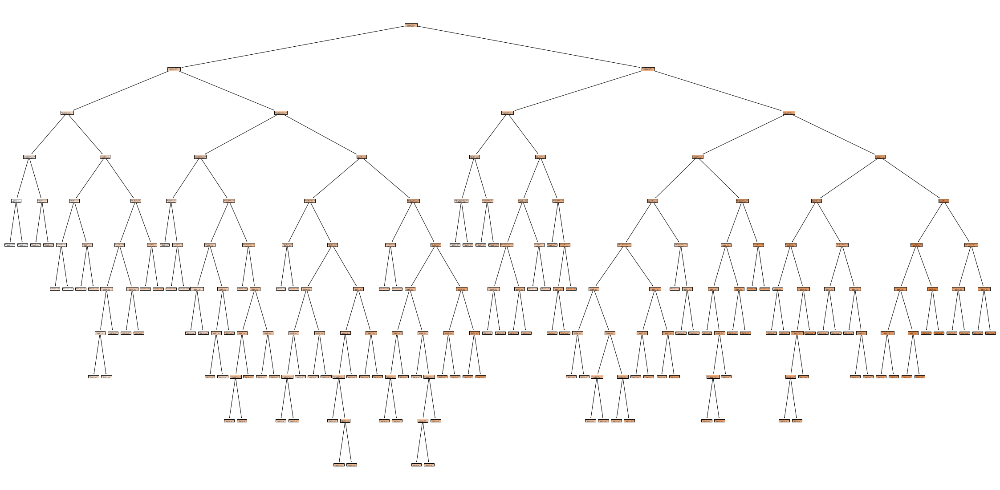

 44%|████▍     | 44/100 [04:23<05:38,  6.05s/it]

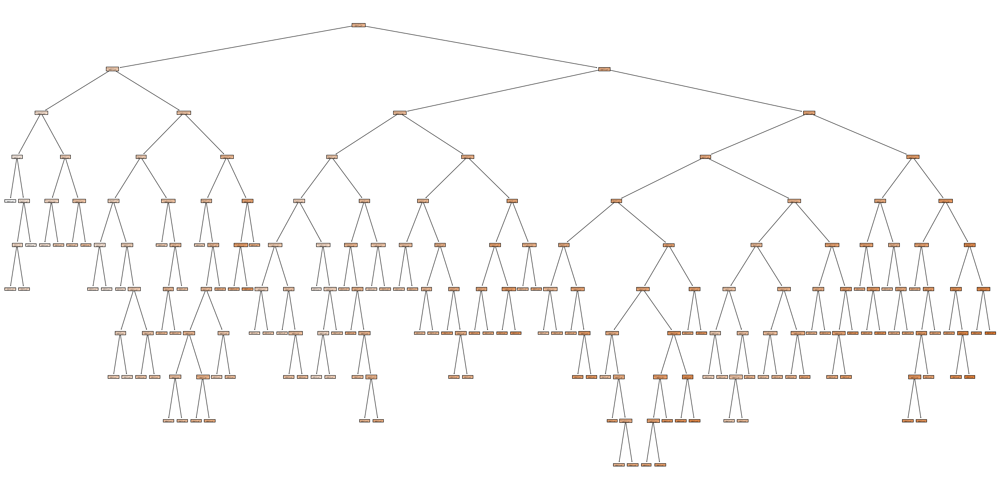

 45%|████▌     | 45/100 [04:29<05:28,  5.98s/it]

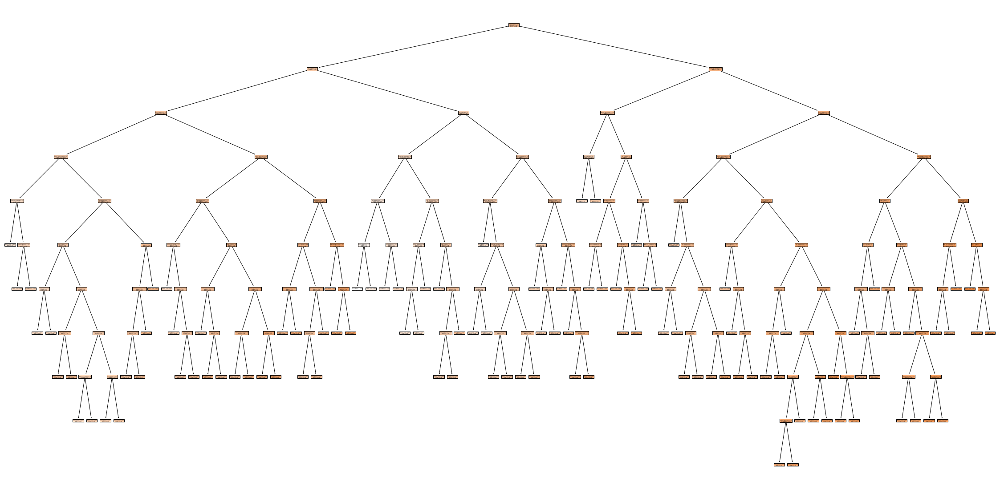

 46%|████▌     | 46/100 [04:35<05:24,  6.01s/it]

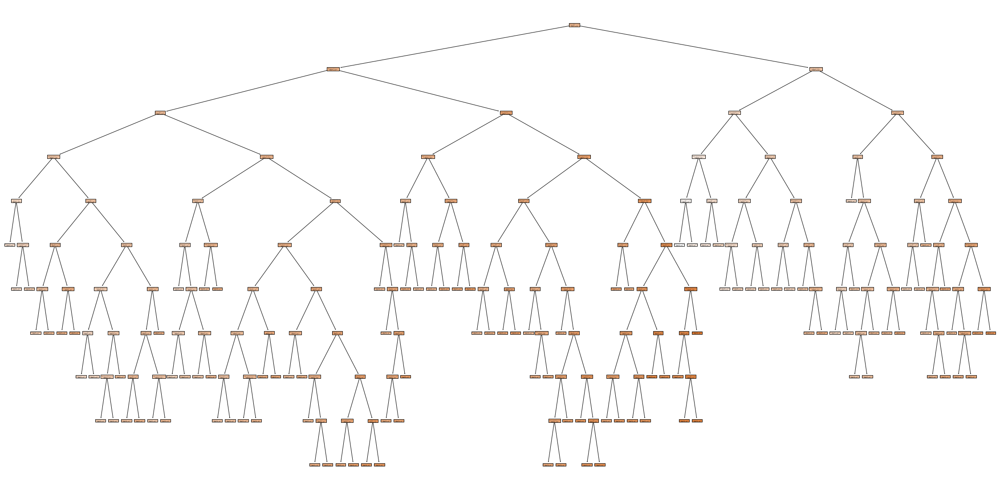

 47%|████▋     | 47/100 [04:41<05:19,  6.04s/it]

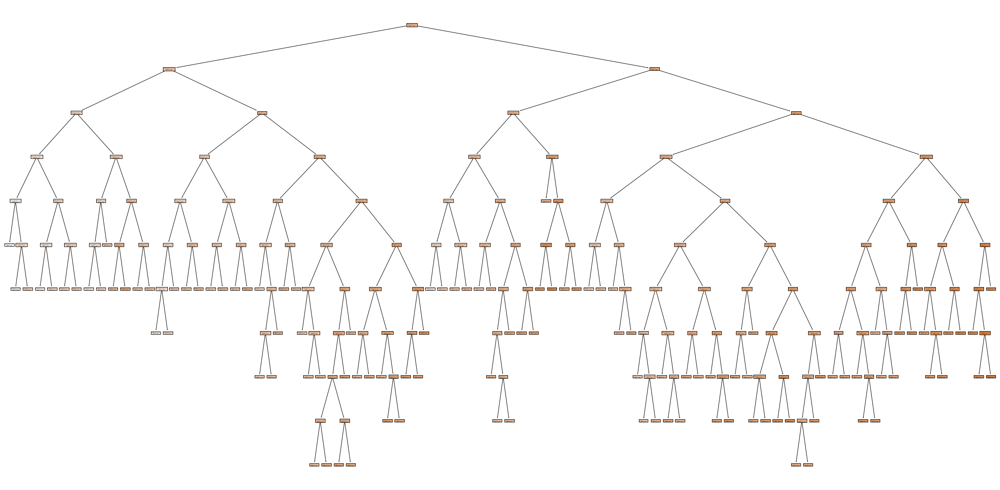

 48%|████▊     | 48/100 [04:47<05:13,  6.04s/it]

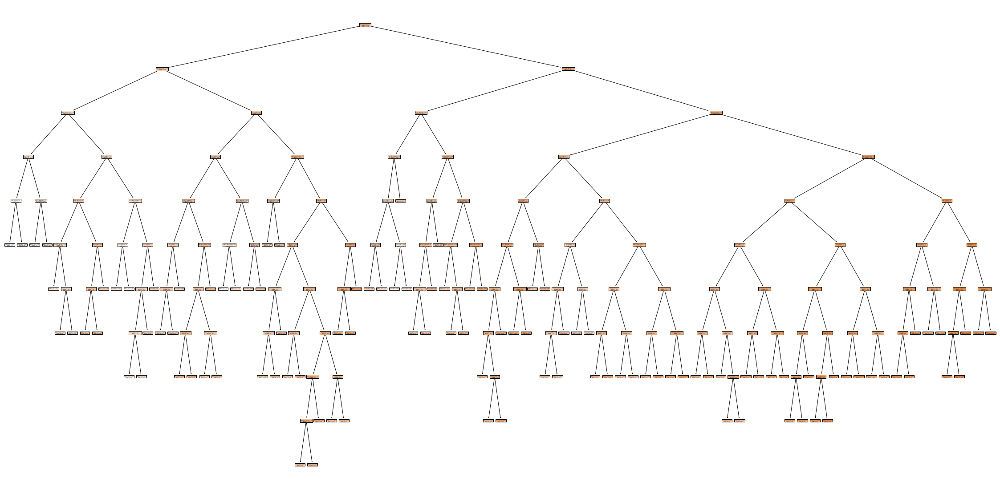

 49%|████▉     | 49/100 [04:53<05:05,  5.99s/it]

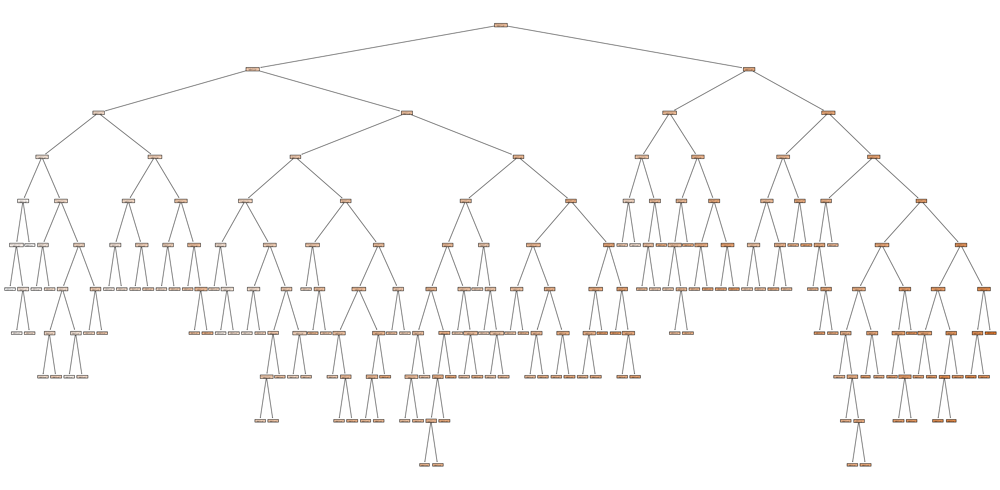

 50%|█████     | 50/100 [04:59<04:58,  5.98s/it]

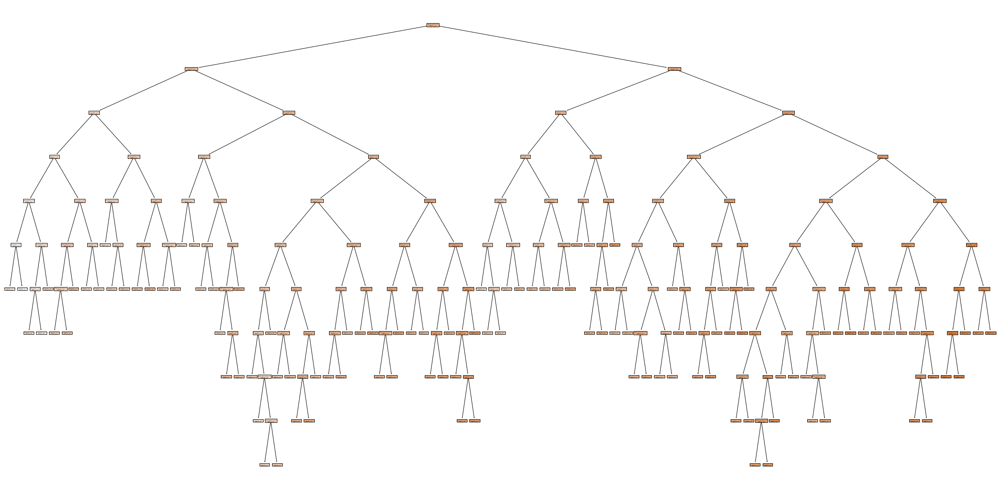

 51%|█████     | 51/100 [05:05<04:53,  5.99s/it]

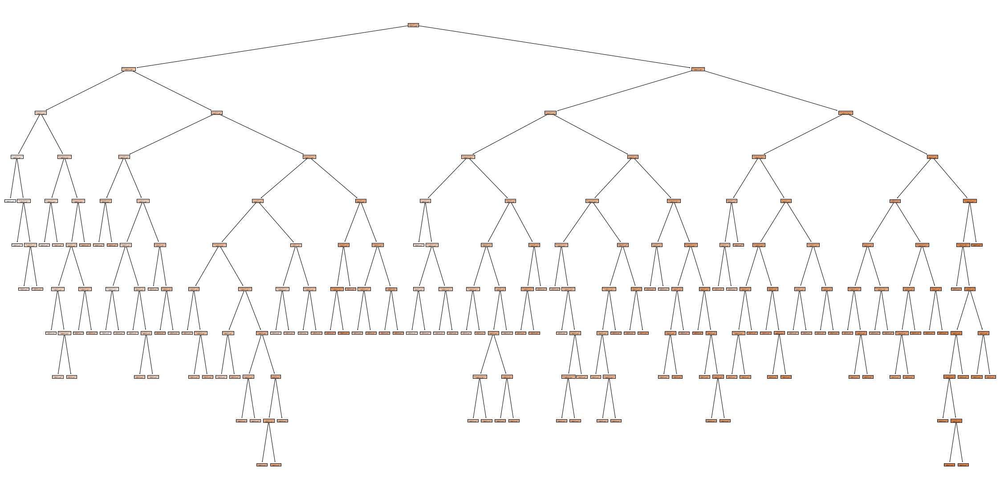

 52%|█████▏    | 52/100 [05:11<04:47,  5.99s/it]

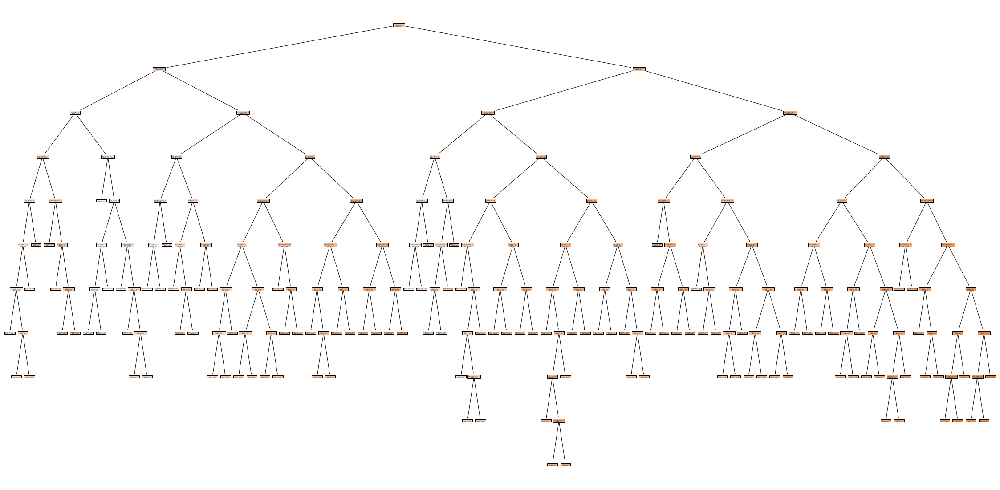

 53%|█████▎    | 53/100 [05:17<04:41,  6.00s/it]

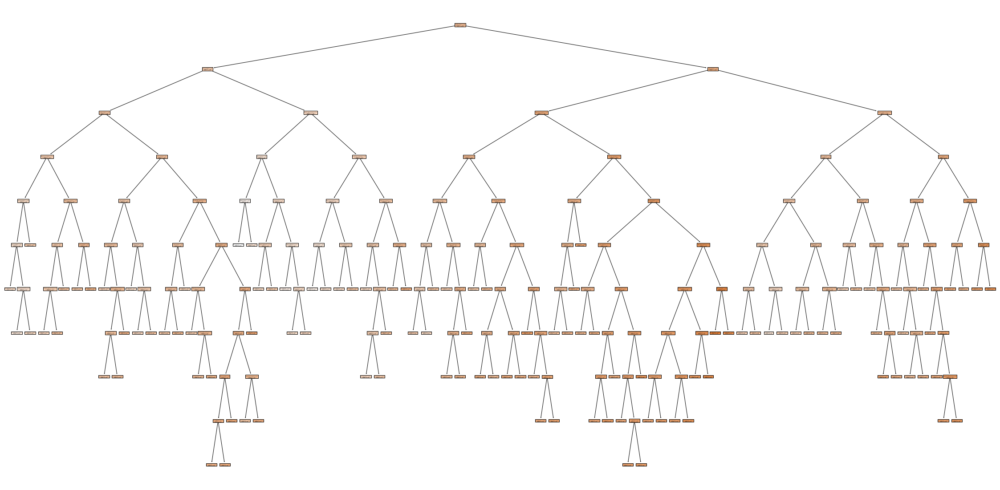

 54%|█████▍    | 54/100 [05:23<04:36,  6.01s/it]

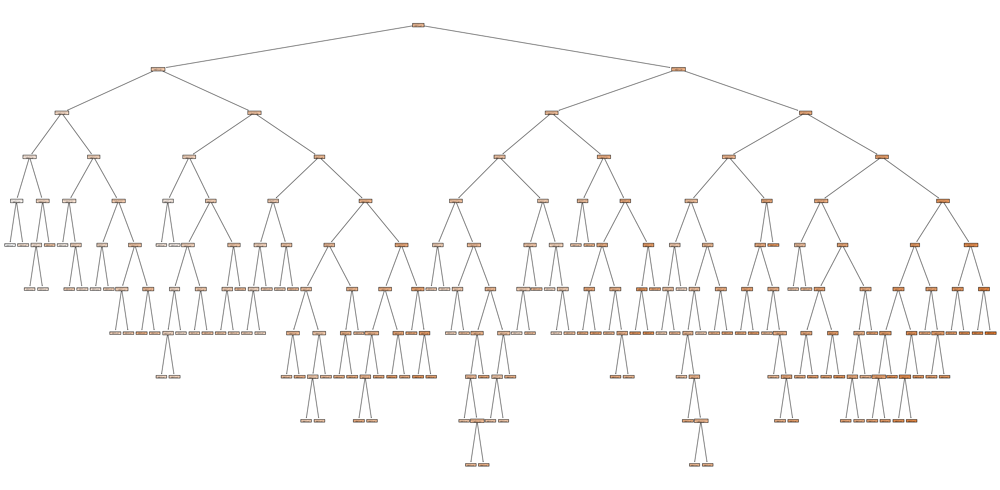

 55%|█████▌    | 55/100 [05:29<04:32,  6.05s/it]

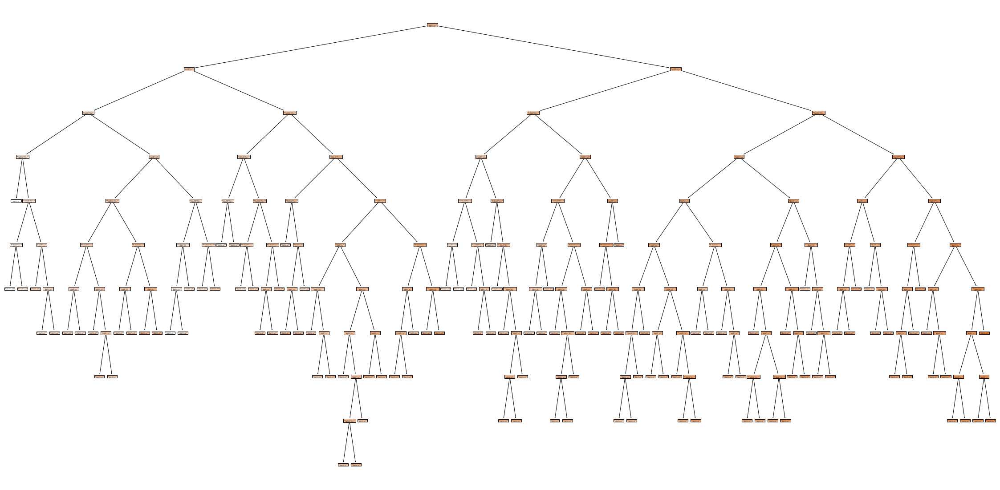

 56%|█████▌    | 56/100 [05:36<04:29,  6.12s/it]

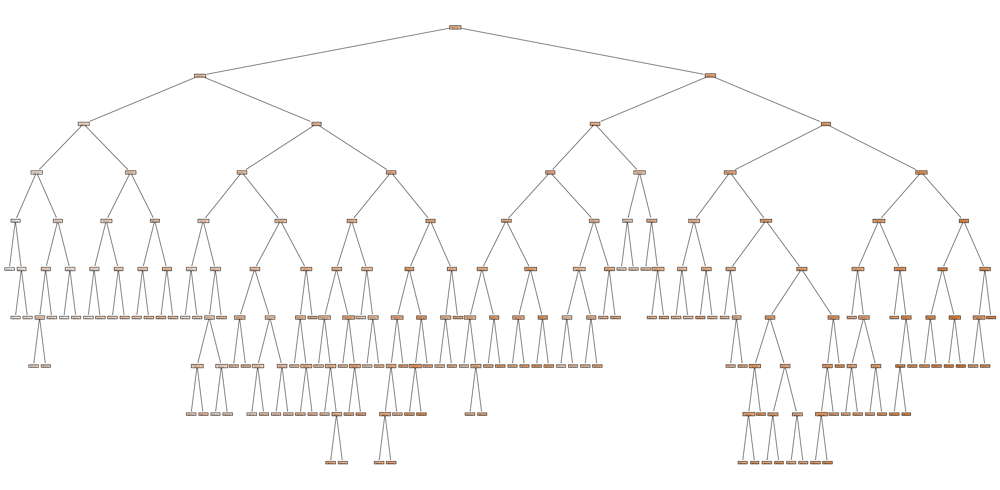

 57%|█████▋    | 57/100 [05:42<04:20,  6.05s/it]

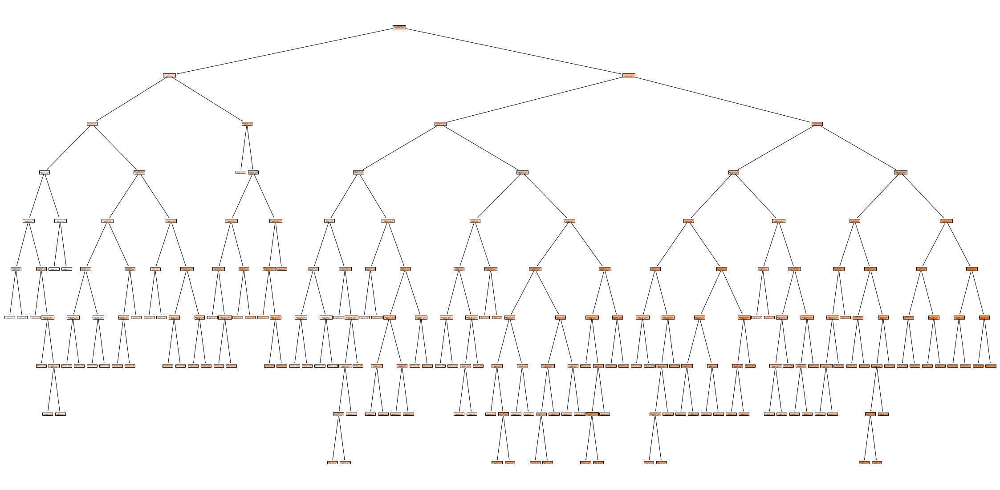

 58%|█████▊    | 58/100 [05:48<04:14,  6.05s/it]

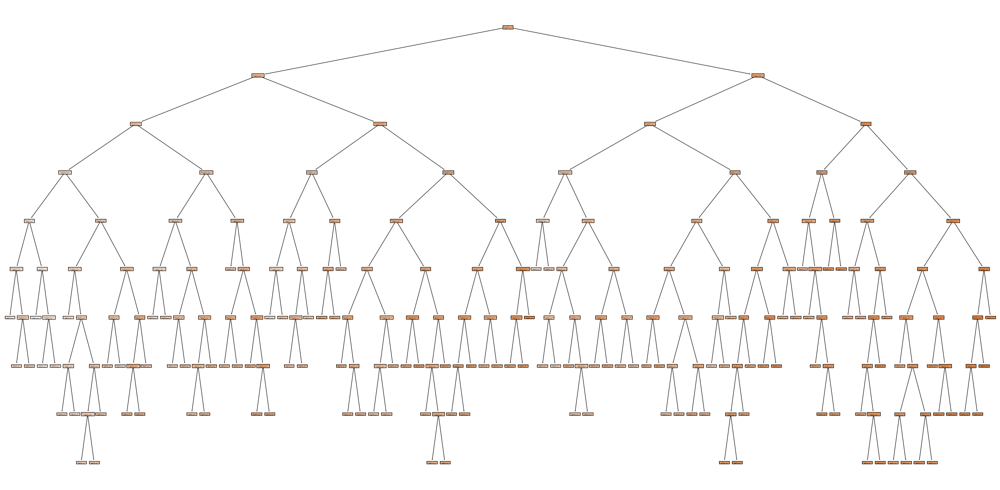

 59%|█████▉    | 59/100 [05:54<04:09,  6.09s/it]

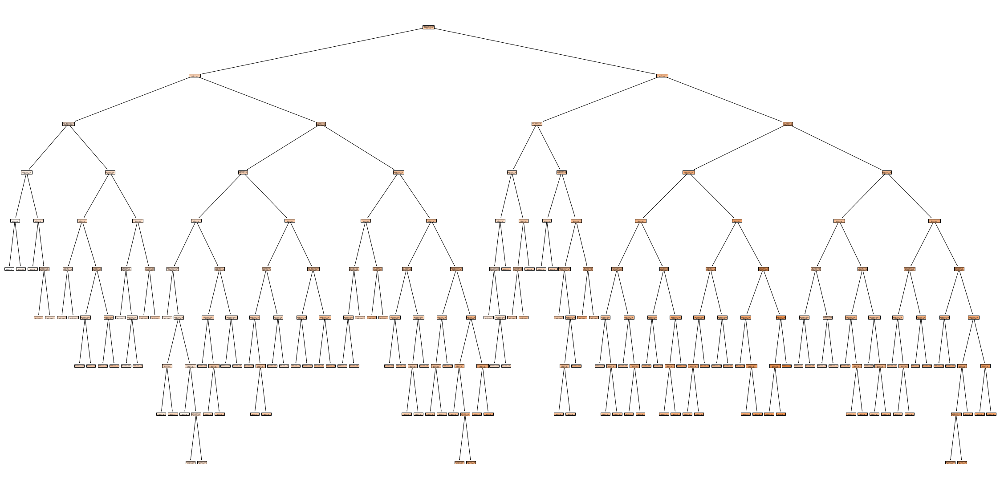

 60%|██████    | 60/100 [06:00<04:04,  6.12s/it]

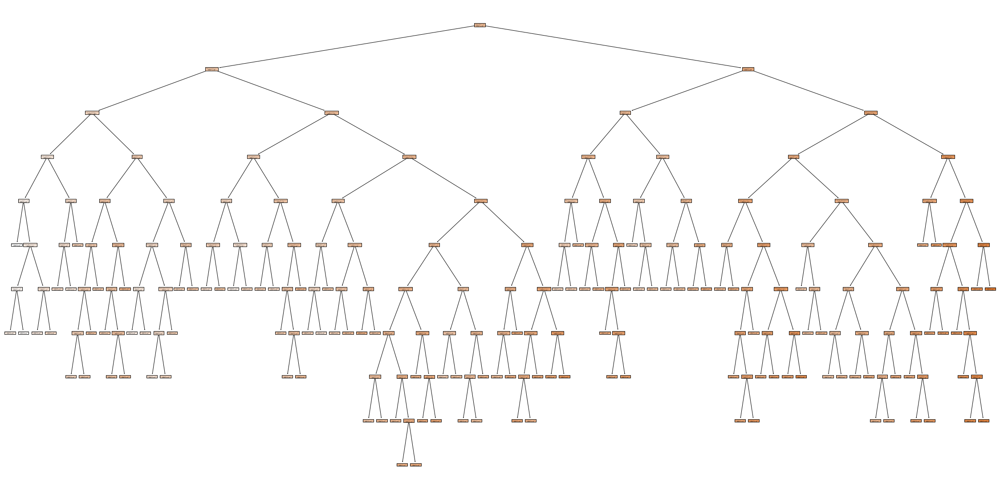

 61%|██████    | 61/100 [06:06<03:58,  6.11s/it]

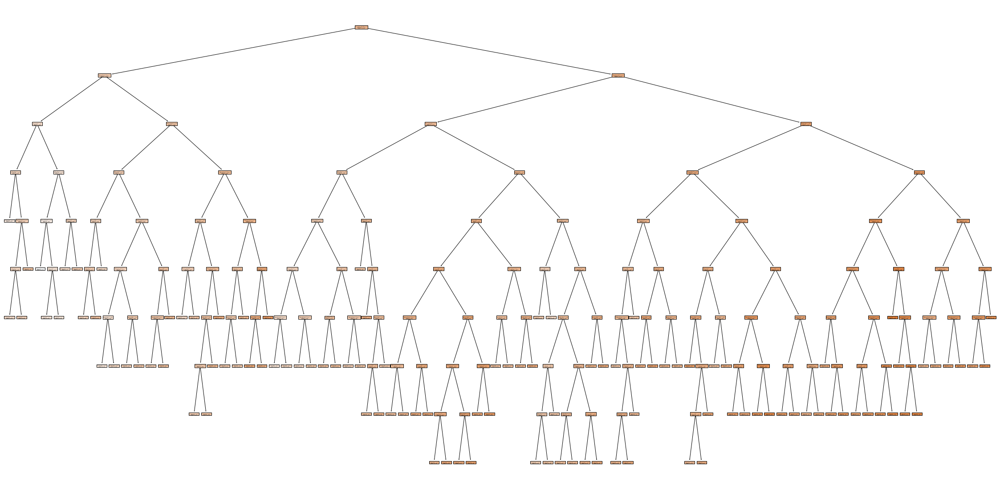

 62%|██████▏   | 62/100 [06:12<03:51,  6.10s/it]

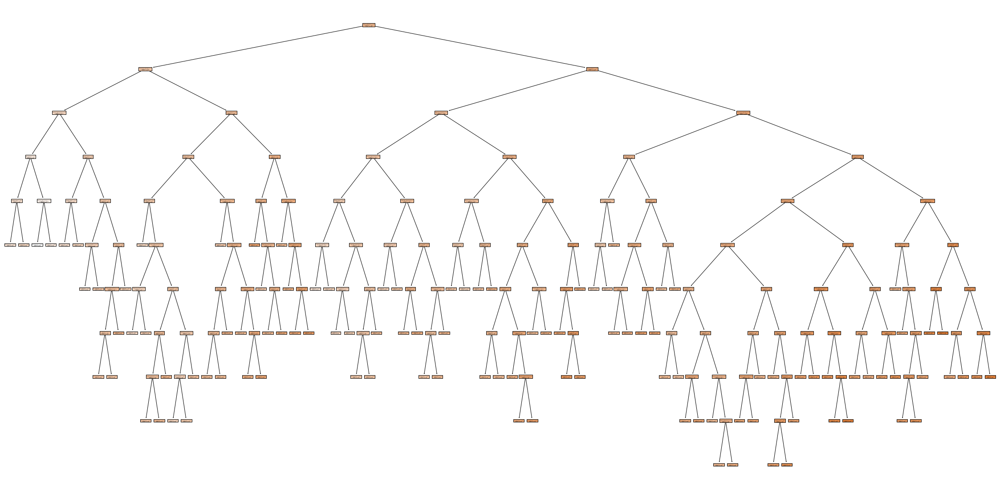

 63%|██████▎   | 63/100 [06:18<03:43,  6.04s/it]

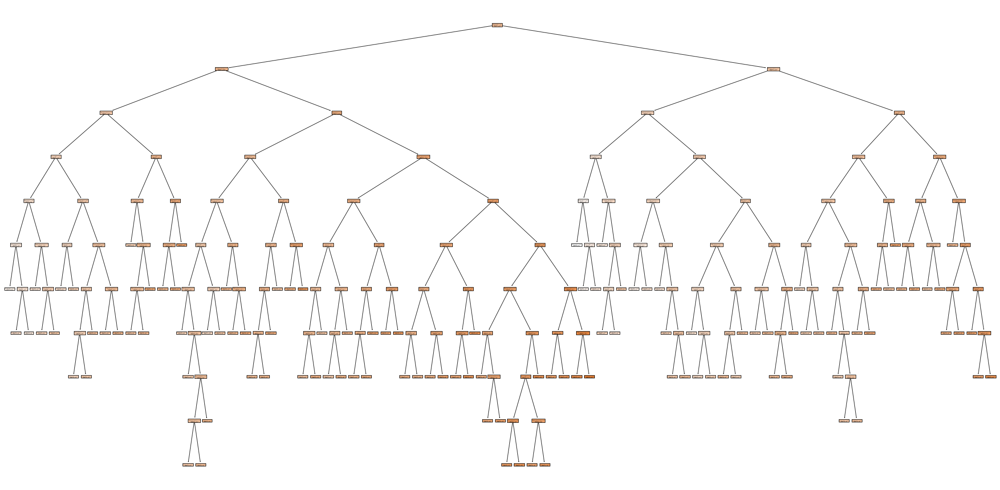

 64%|██████▍   | 64/100 [06:24<03:39,  6.09s/it]

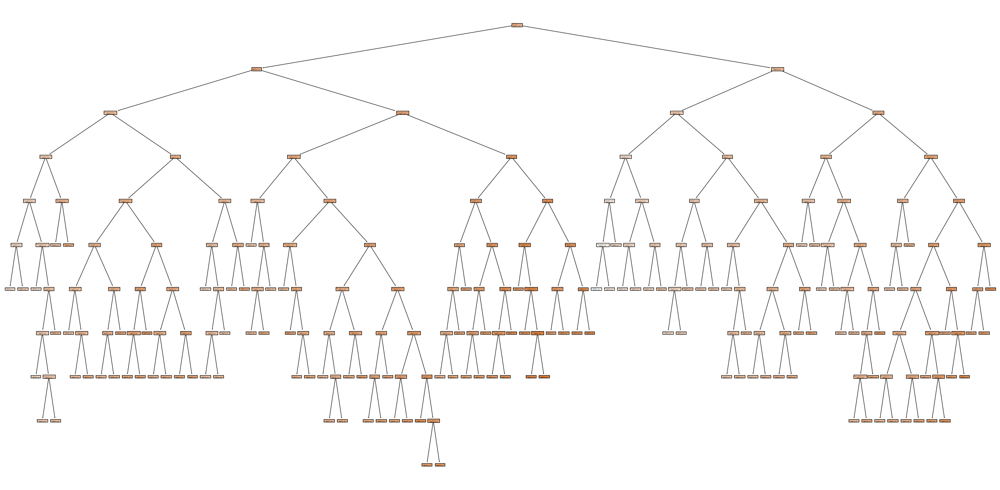

 65%|██████▌   | 65/100 [06:31<03:35,  6.15s/it]

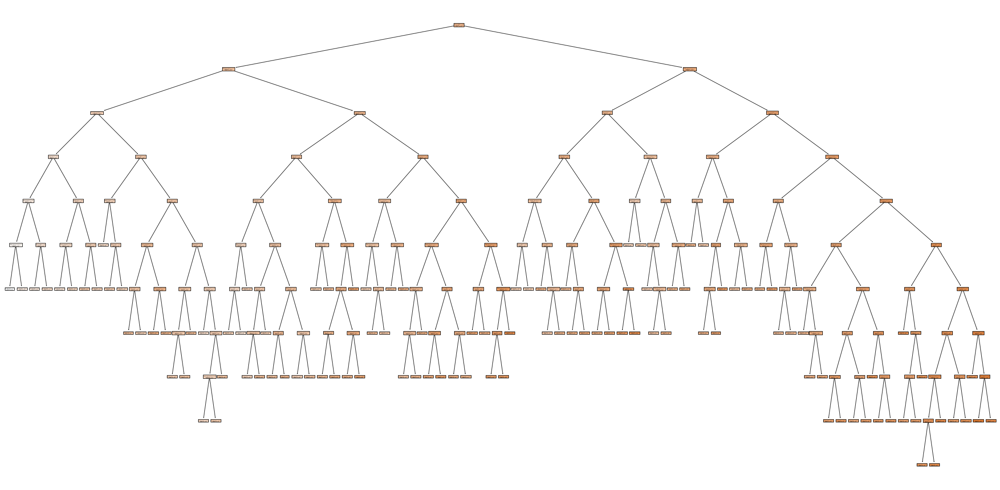

 66%|██████▌   | 66/100 [06:37<03:28,  6.14s/it]

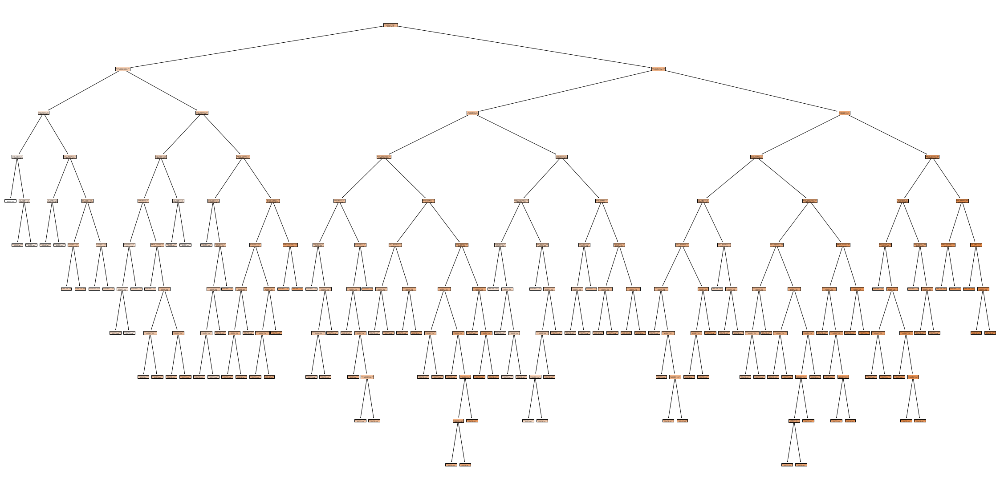

 67%|██████▋   | 67/100 [06:43<03:21,  6.09s/it]

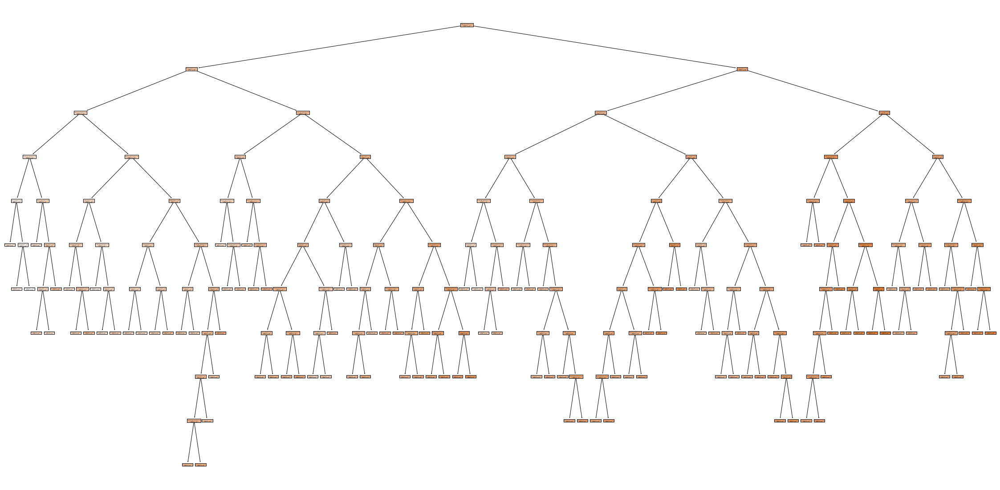

 68%|██████▊   | 68/100 [06:49<03:13,  6.05s/it]

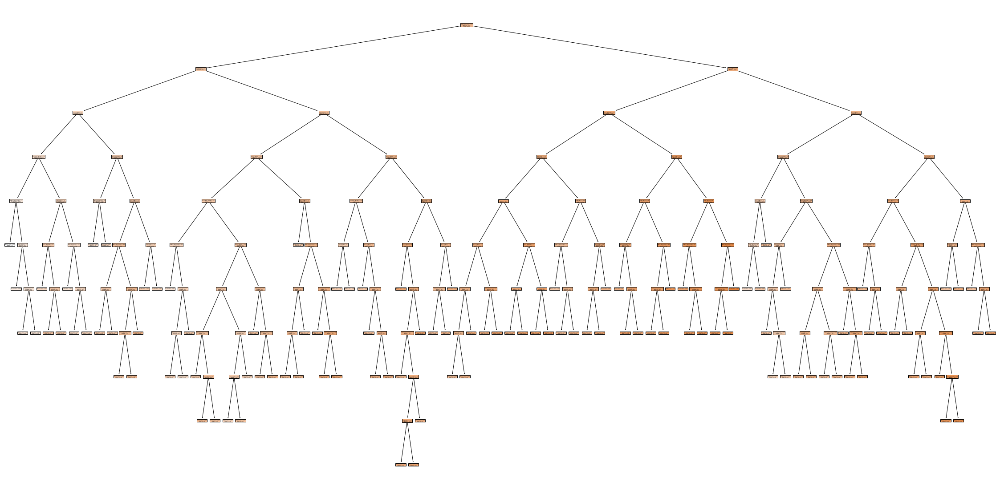

 69%|██████▉   | 69/100 [06:55<03:07,  6.04s/it]

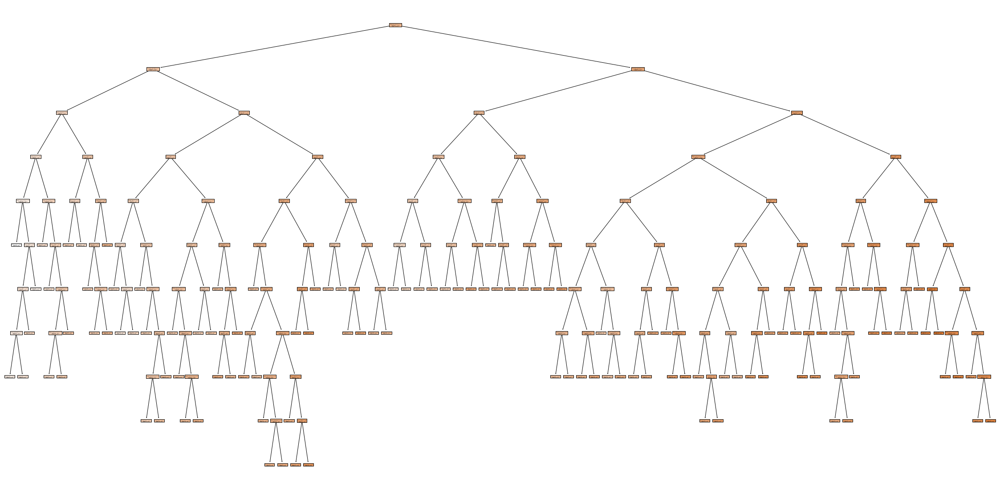

 70%|███████   | 70/100 [07:01<03:01,  6.05s/it]

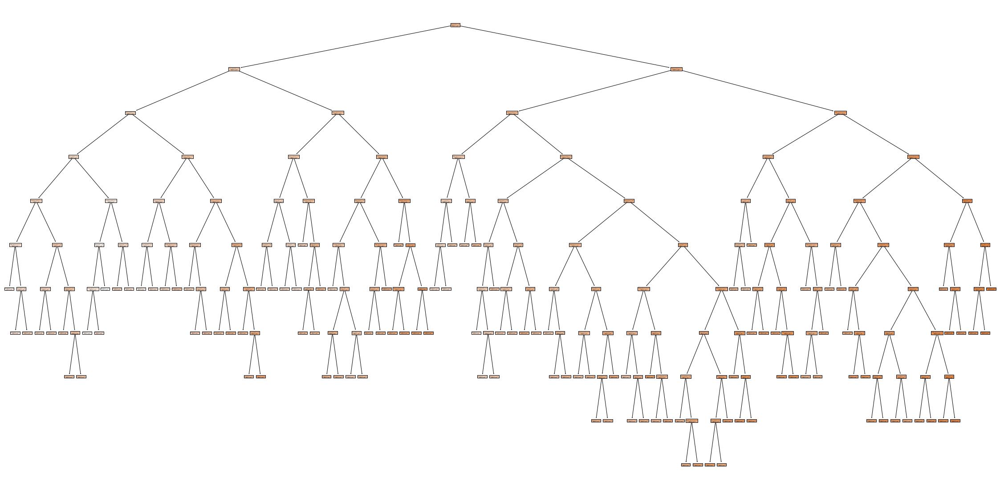

 71%|███████   | 71/100 [07:07<02:58,  6.14s/it]

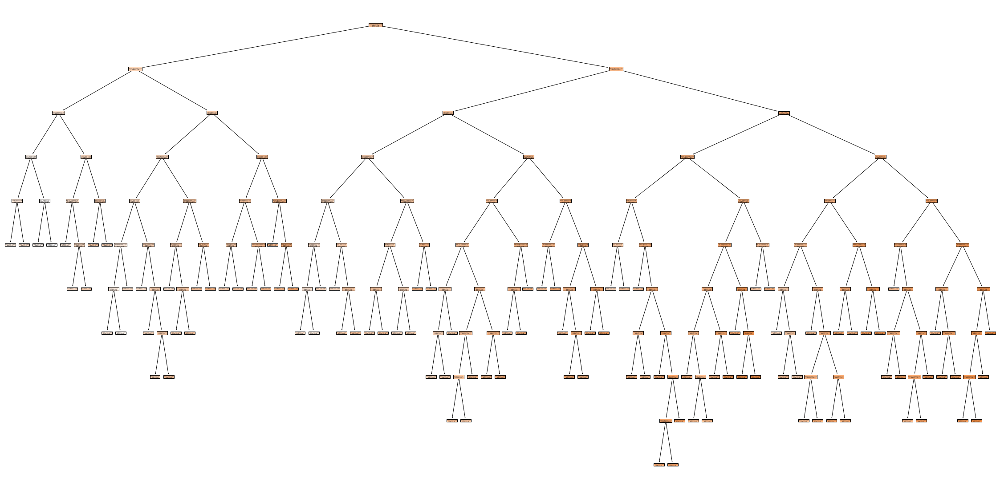

 72%|███████▏  | 72/100 [07:13<02:47,  6.00s/it]

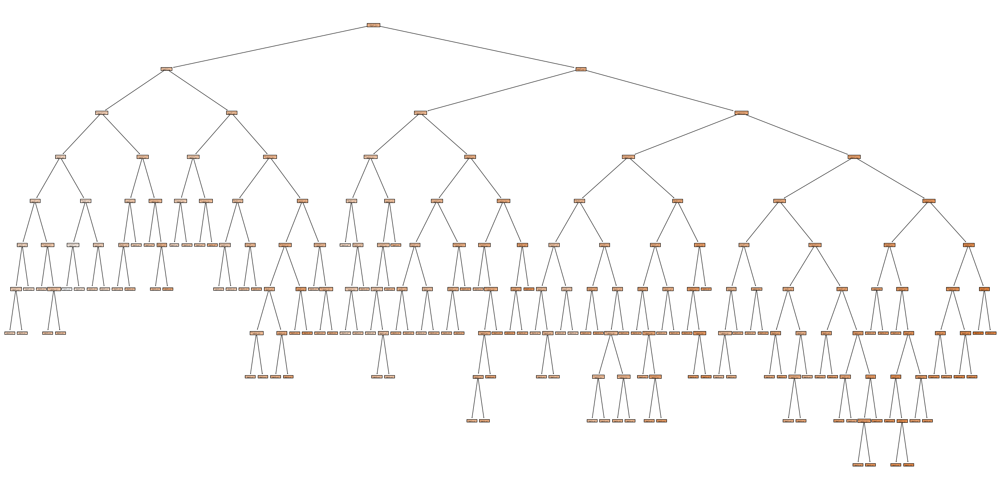

 73%|███████▎  | 73/100 [07:19<02:42,  6.00s/it]

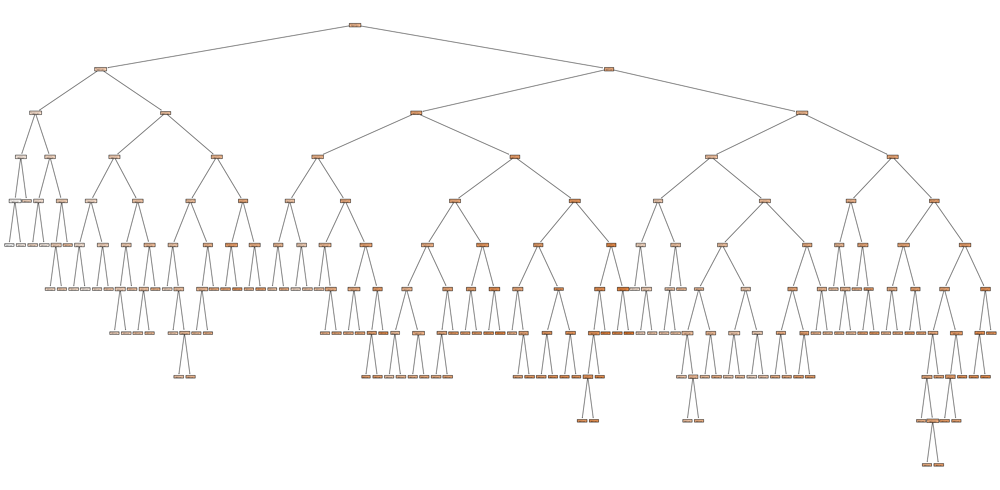

 74%|███████▍  | 74/100 [07:25<02:34,  5.95s/it]

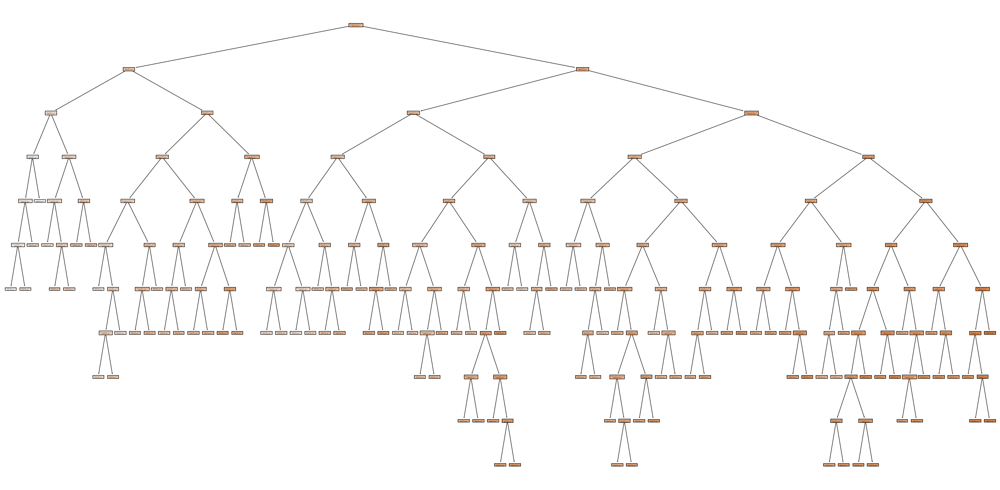

 75%|███████▌  | 75/100 [07:30<02:27,  5.89s/it]

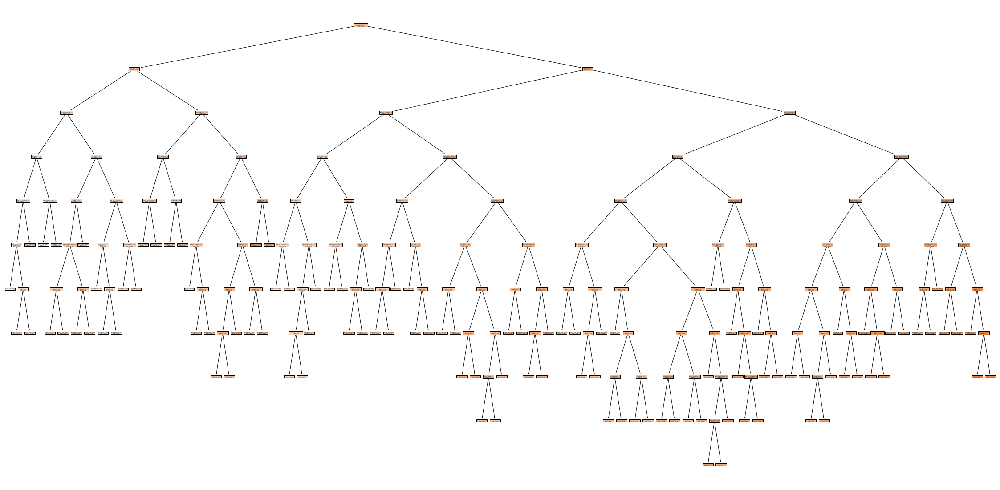

 76%|███████▌  | 76/100 [07:36<02:22,  5.95s/it]

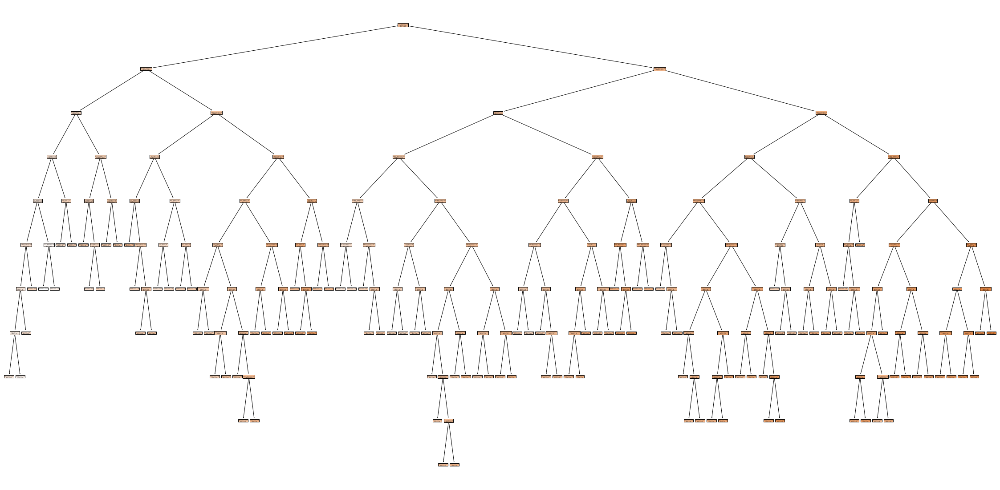

 77%|███████▋  | 77/100 [07:43<02:18,  6.01s/it]

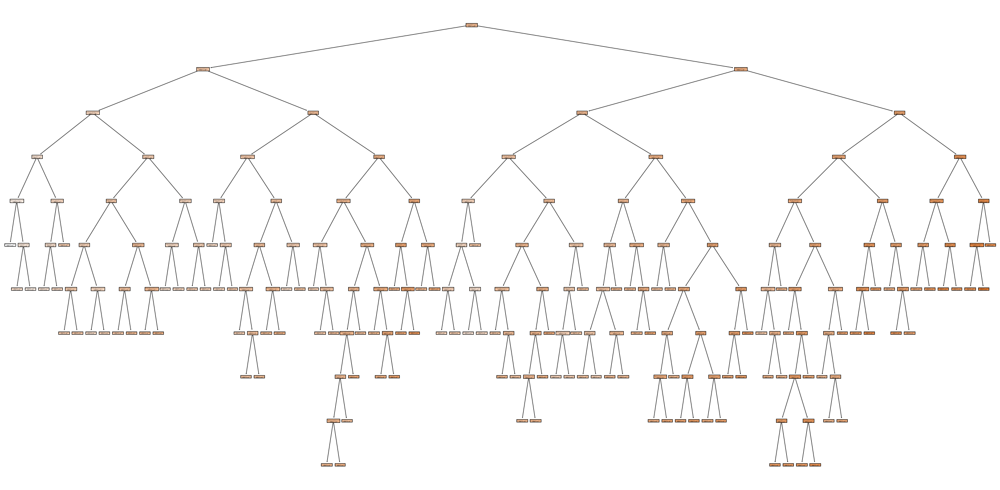

 78%|███████▊  | 78/100 [07:48<02:11,  5.98s/it]

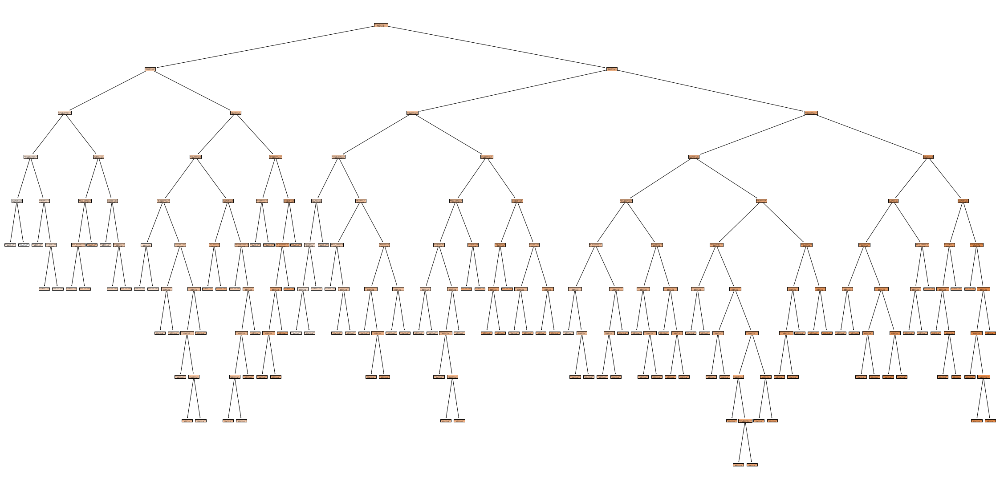

 79%|███████▉  | 79/100 [07:54<02:04,  5.91s/it]

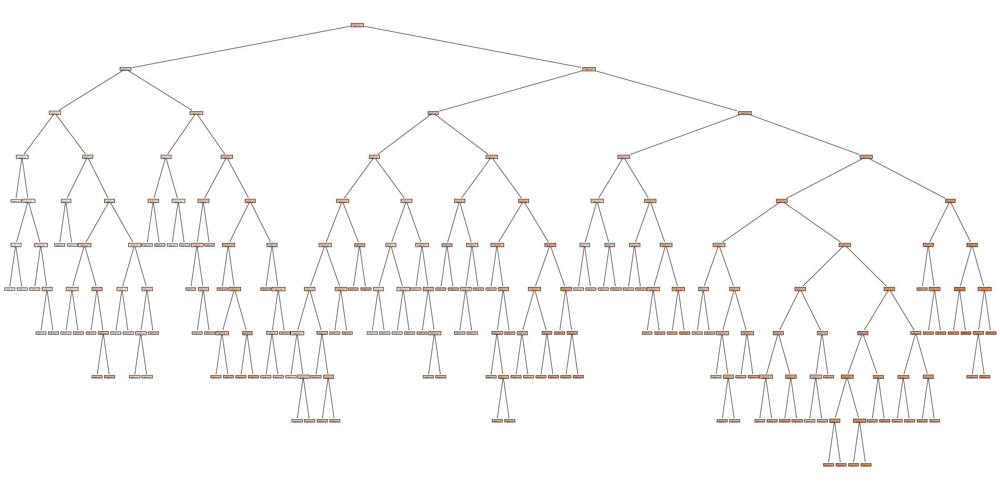

 80%|████████  | 80/100 [08:00<02:00,  6.01s/it]

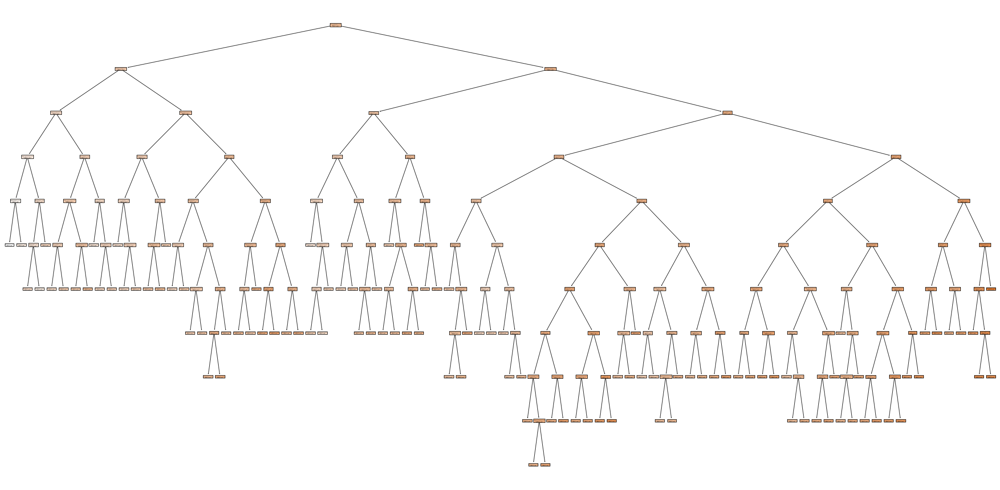

 81%|████████  | 81/100 [08:06<01:53,  5.98s/it]

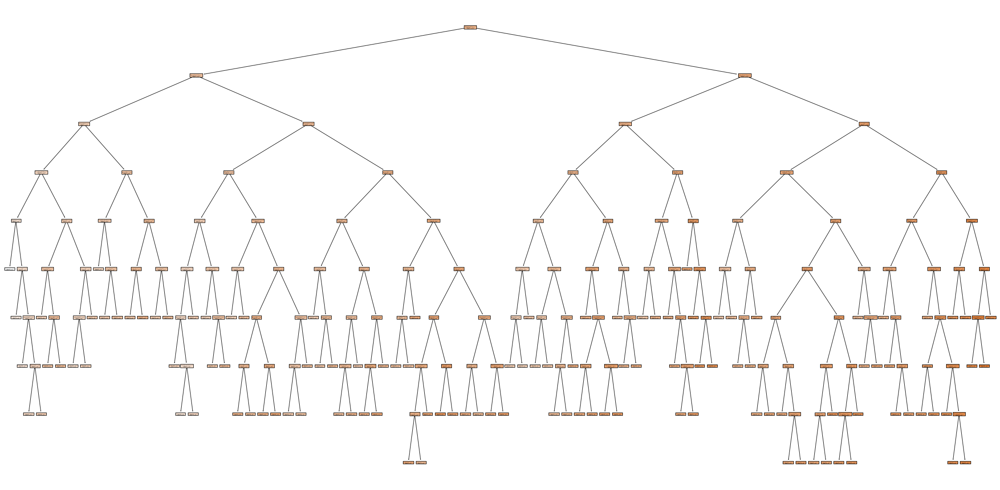

 82%|████████▏ | 82/100 [08:13<01:49,  6.11s/it]

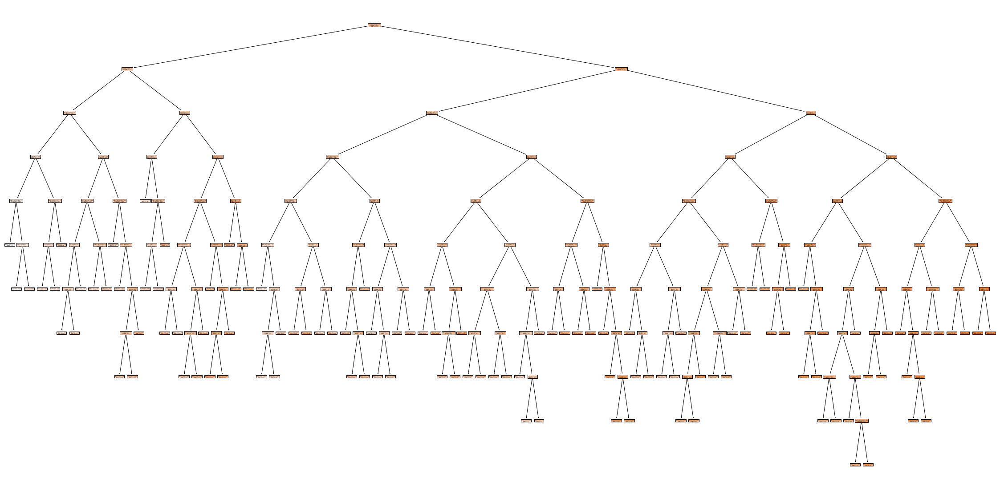

 83%|████████▎ | 83/100 [08:19<01:44,  6.12s/it]

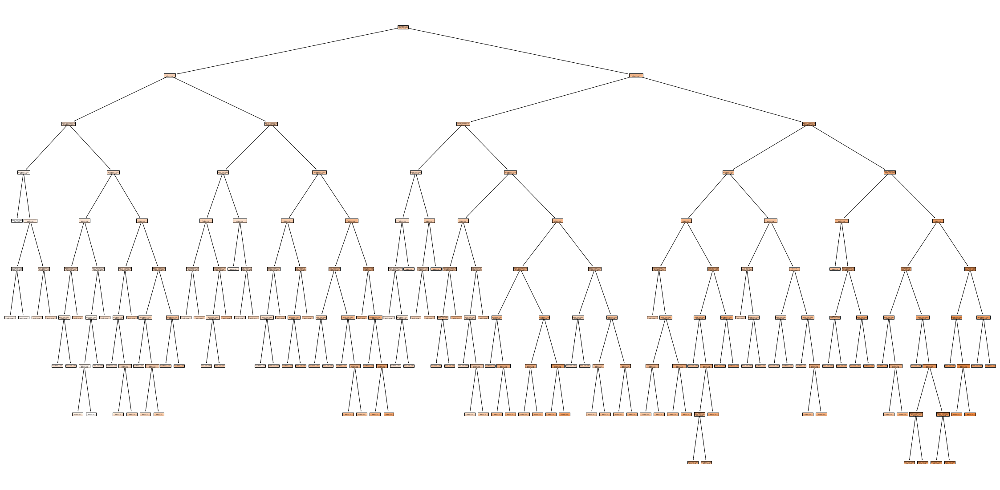

 84%|████████▍ | 84/100 [08:25<01:37,  6.09s/it]

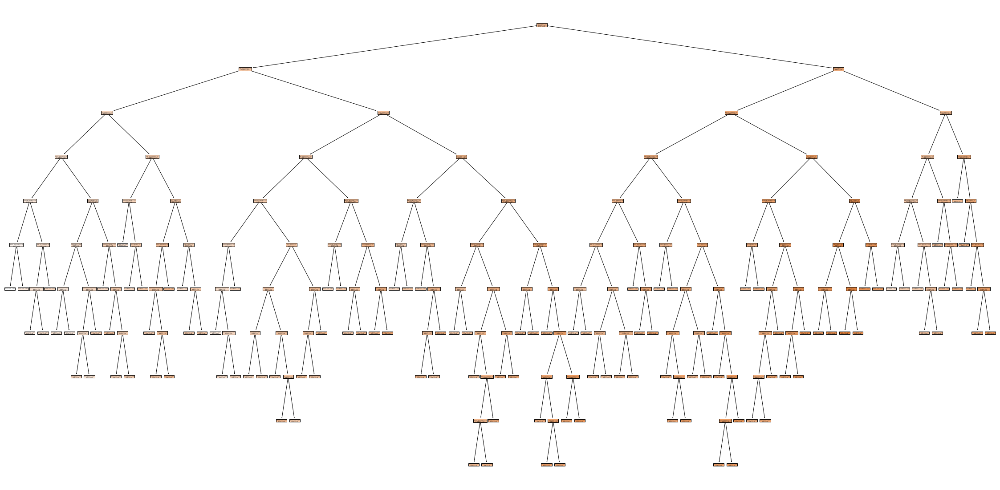

 85%|████████▌ | 85/100 [08:31<01:32,  6.17s/it]

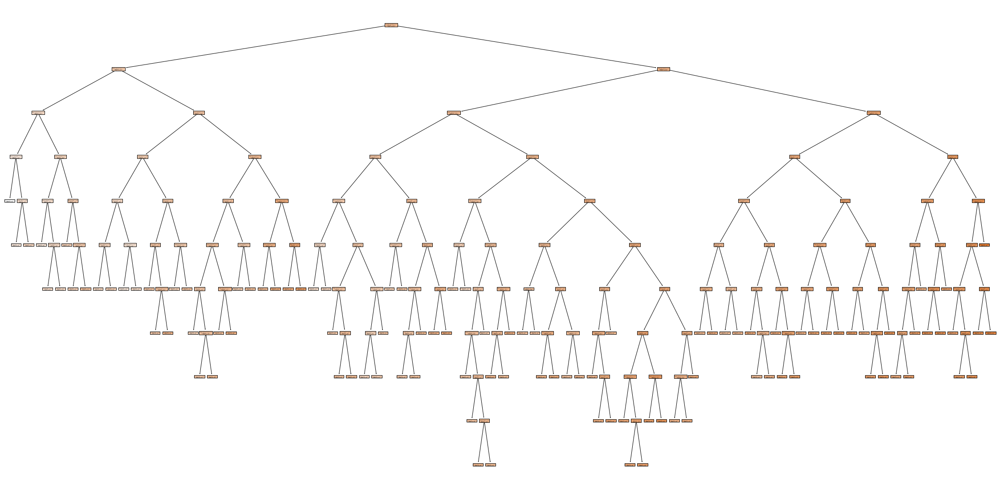

 86%|████████▌ | 86/100 [08:37<01:24,  6.06s/it]

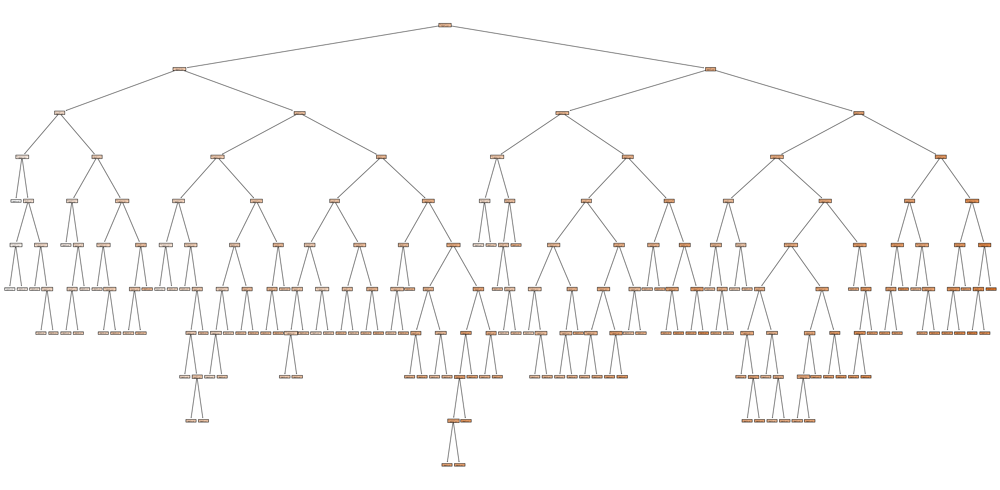

 87%|████████▋ | 87/100 [08:43<01:18,  6.08s/it]

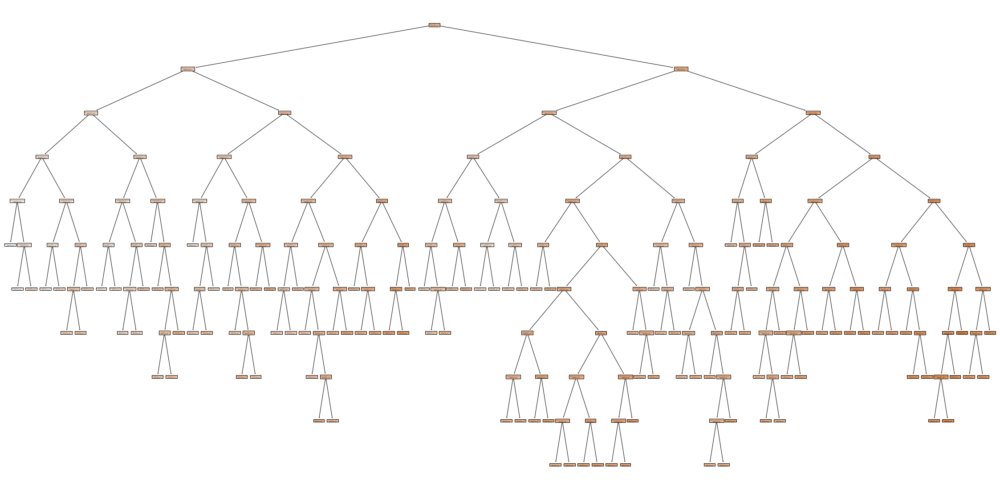

 88%|████████▊ | 88/100 [08:49<01:12,  6.04s/it]

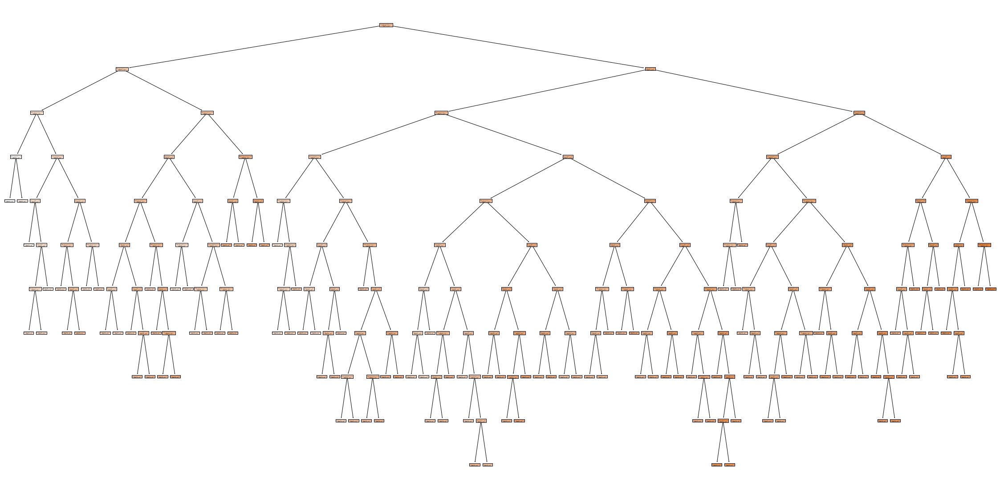

 89%|████████▉ | 89/100 [08:56<01:07,  6.12s/it]

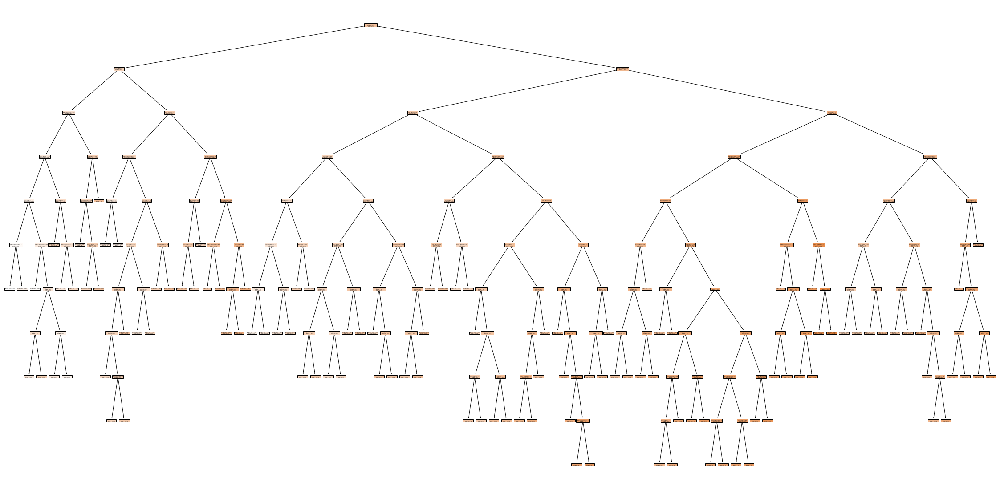

 90%|█████████ | 90/100 [09:02<01:01,  6.16s/it]

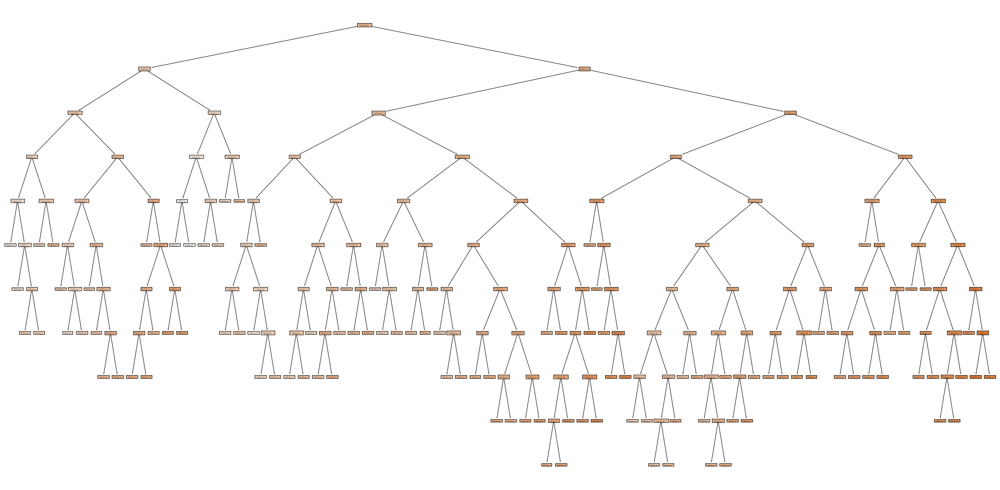

 91%|█████████ | 91/100 [09:08<00:54,  6.08s/it]

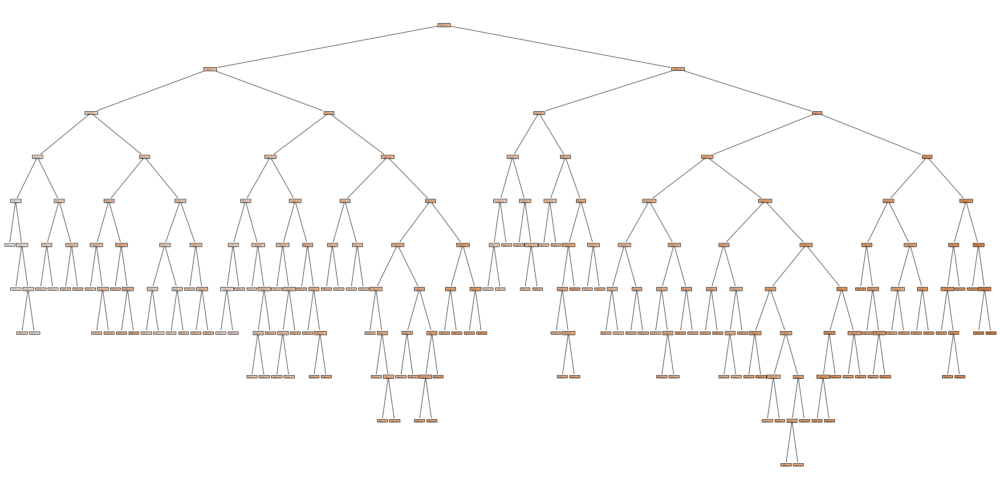

 92%|█████████▏| 92/100 [09:14<00:48,  6.05s/it]

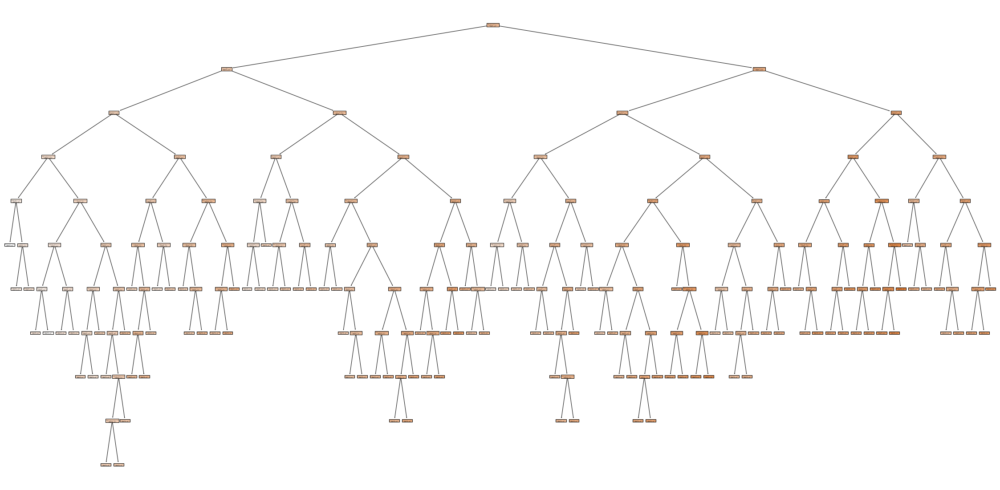

 93%|█████████▎| 93/100 [09:19<00:41,  5.99s/it]

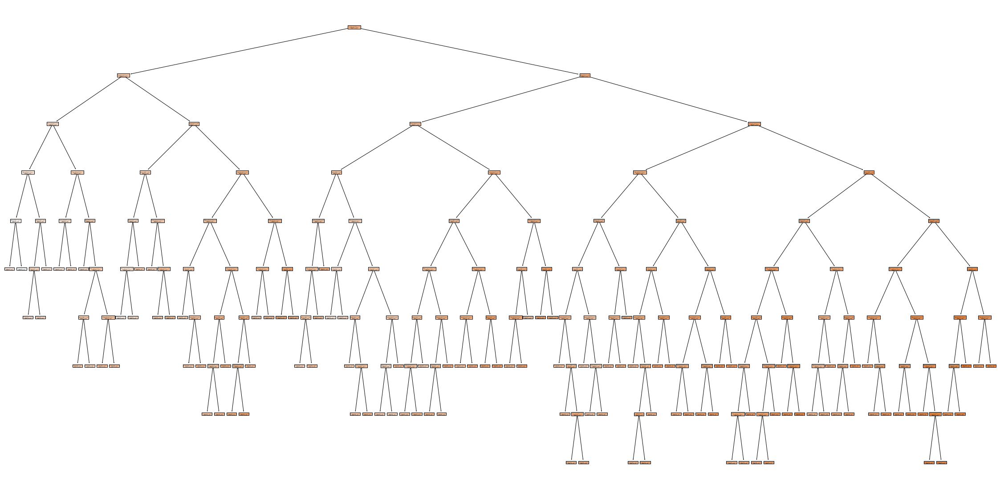

 94%|█████████▍| 94/100 [09:25<00:35,  5.98s/it]

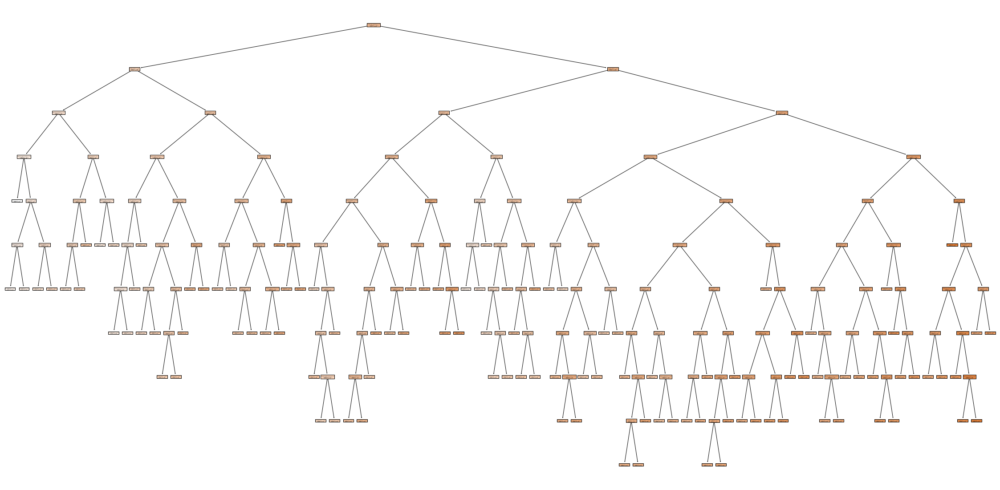

 95%|█████████▌| 95/100 [09:31<00:30,  6.00s/it]

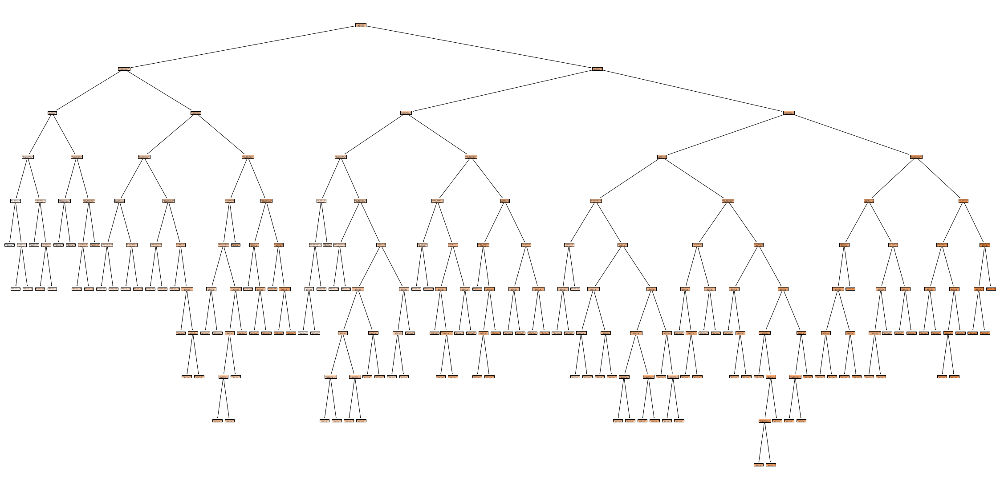

 96%|█████████▌| 96/100 [09:38<00:24,  6.05s/it]

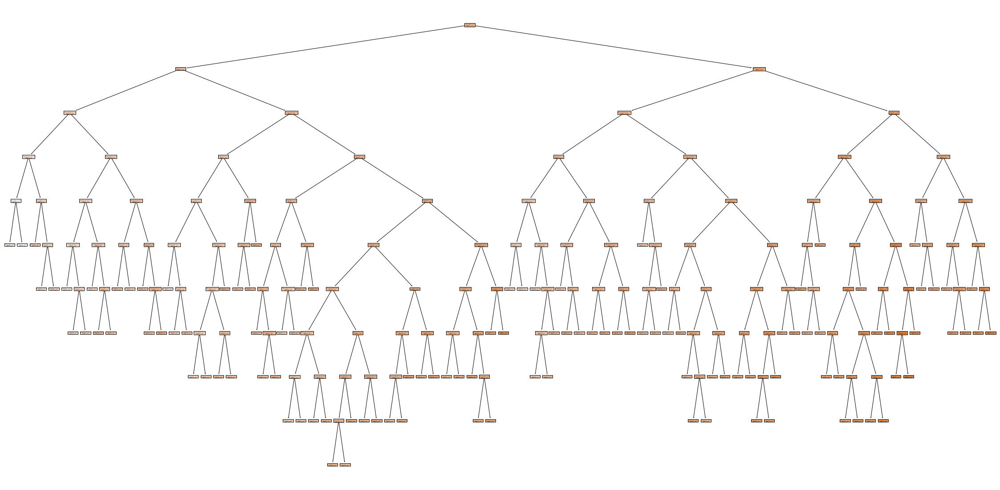

 97%|█████████▋| 97/100 [09:44<00:18,  6.09s/it]

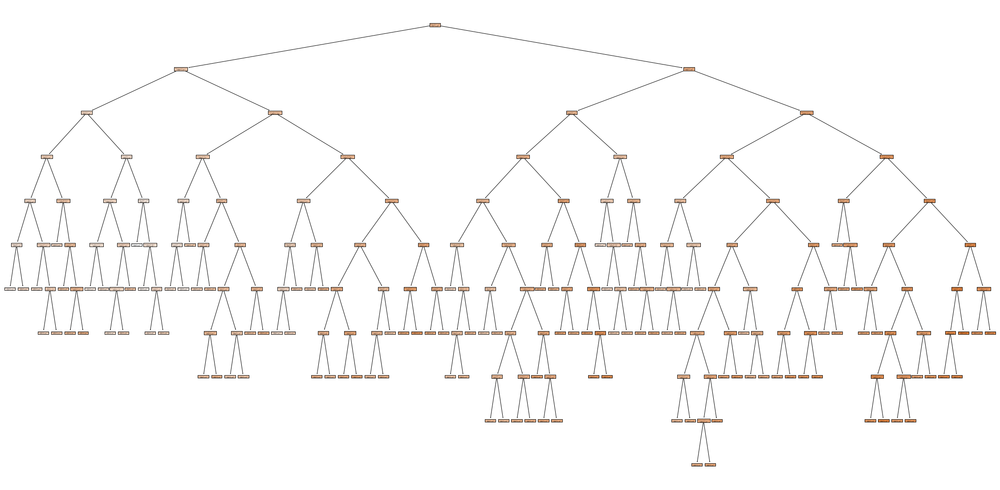

 98%|█████████▊| 98/100 [09:50<00:12,  6.11s/it]

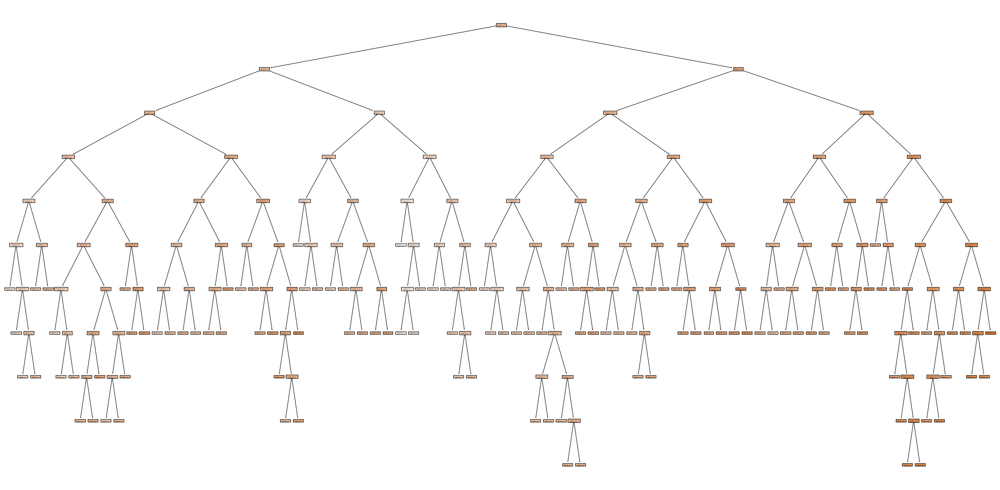

 99%|█████████▉| 99/100 [09:56<00:06,  6.14s/it]

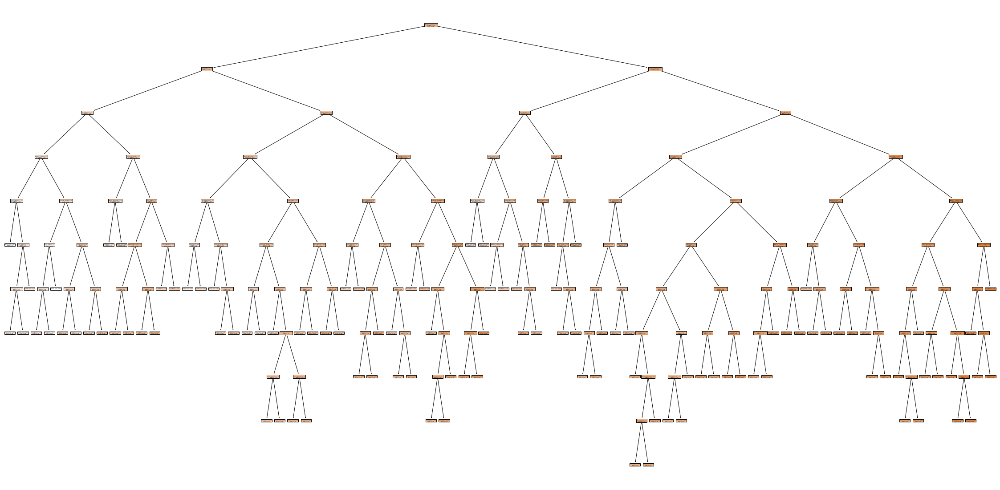

100%|██████████| 100/100 [10:02<00:00,  6.03s/it]


In [21]:
# los árboles de nuestro bosque

for arbol in tqdm(bosque.estimators_):
    fig = plt.figure(figsize=(40, 20))
    tree.plot_tree(arbol, feature_names= x_train.columns, filled = True)
    plt.show()

# Calculamos las métricas de nuestro modelo

In [38]:
c

In [40]:
def metricas(y_test, y_train, y_test_pred, y_train_pred, tipo_modelo):
    
    
    resultados = {'MAE': [mean_absolute_error(y_test, y_test_pred), mean_absolute_error(y_train, y_train_pred)],
                'MSE': [mean_squared_error(y_test, y_test_pred), mean_squared_error(y_train, y_train_pred)],
                'RMSE': [np.sqrt(mean_squared_error(y_test, y_test_pred)), np.sqrt(mean_squared_error(y_train, y_train_pred))],
                'R2':  [r2_score(y_test, y_test_pred), r2_score(y_train, y_train_pred)],
                 "set": ["test", "train"]}
    df = pd.DataFrame(resultados)
    df["modelo"] = tipo_modelo
    return df

In [41]:

# sacamos las métricas para ver si hay overfitting o underfitting, para modificar la profundidad en función de estos resultados

dt_results = metricas(y_test, y_train, y_pred_test_rf, y_pred_train_rf, "Random Forest")
dt_results

,MAE,MSE,RMSE,R2,set,modelo
0,0.363715,0.207775,0.455824,0.725786,test,Random Forest
1,0.345429,0.187481,0.432990,0.756107,train,Random Forest


In [43]:
# igual que en la clase de decision tree, juntemos estos resultados con los obtenidos en los modelos que hemos hecho hasta ahora
# lo primero que tenemos que hacer es cargar el csv con todos los resultados que guardamos en el jupyter anterior

df_LR_DT_results = pd.read_csv("/wellness_11.csv", index_col = 0)
df_LR_DT_results



,MAE,MSE,RMSE,R2,set,modelo
0,1.373714e-02,3.948336e-04,1.987042e-02,0.999479,test,Linear Regresion
1,1.397905e-02,4.173375e-04,2.042884e-02,0.999457,train,LinearRegression
0,3.172291e-04,1.298802e-05,3.603889e-03,0.999983,test,Decission Tree I
1,2.654947e-15,1.939096e-29,4.403517e-15,1.000000,train,Decission Tree I
0,2.207468e-01,9.693751e-02,3.113479e-01,0.872066,test,Decision tree II
1,2.183687e-01,9.496048e-02,3.081566e-01,0.876466,train,Decision tree II


In [44]:
# concatenamos el csv anterior con los resultados obtenidos en este modelo

df_todos_resultados = pd.concat([dt_results, df_LR_DT_results], axis = 0)
df_todos_resultados

,MAE,MSE,RMSE,R2,set,modelo
0,3.637146e-01,2.077754e-01,4.558239e-01,0.725786,test,Random Forest
1,3.454292e-01,1.874806e-01,4.329903e-01,0.756107,train,Random Forest
0,1.373714e-02,3.948336e-04,1.987042e-02,0.999479,test,Linear Regresion
1,1.397905e-02,4.173375e-04,2.042884e-02,0.999457,train,LinearRegression
0,3.172291e-04,1.298802e-05,3.603889e-03,0.999983,test,Decission Tree I
1,2.654947e-15,1.939096e-29,4.403517e-15,1.000000,train,Decission Tree I
0,2.207468e-01,9.693751e-02,3.113479e-01,0.872066,test,Decision tree II
1,2.183687e-01,9.496048e-02,3.081566e-01,0.876466,train,Decision tree II


- Recordando:

  - overfitting: Si los valores del train son MUCHO MEJOR=> valor de R2 más alto y las otras métricas más bajas;
  - underfitting: Si los valores del train son MUCHO PEOR => valor  R2 más bajo y las otras métricas más altas en comparación con los valores del test.

Decision Tree I presenta el valor de R2 más alto y las restantes métricas más bajas => overfitting;
Linear Regresion el R2 ligeramente más bajo y las métrica más altas=> underfitting;


In [45]:
# vamos a crearnos un dataframe, igual que hicimos en la clase anterior con la importancia de cada una de las variables incluidas en el modelo

importancia_predictores = pd.DataFrame(
                            {'predictor': x_train.columns,
                             'importancia': bosque.feature_importances_}
                            )


# ordenamos de mayor a menor los resultados
importancia_predictores.sort_values(by=["importancia"], ascending=False, inplace = True)

# printeamos los resultados
print("Importancia de los predictores en el modelo")
print("-------------------------------------------")
importancia_predictores

Importancia de los predictores en el modelo
-------------------------------------------


,predictor,importancia
8,TIME_FOR_PASSION,0.234345
2,CORE_CIRCLE,0.178873
7,SUFFICIENT_INCOME,0.150265
0,FRUITS_VEGGIES,0.112636
9,WEEKLY_MEDITATION,0.097441
5,DAILY_STEPS,0.080243
3,SOCIAL_NETWORK,0.071242
1,DAILY_STRESS,0.036970
4,BMI_RANGE,0.031277
6,SLEEP_HOURS,0.003780


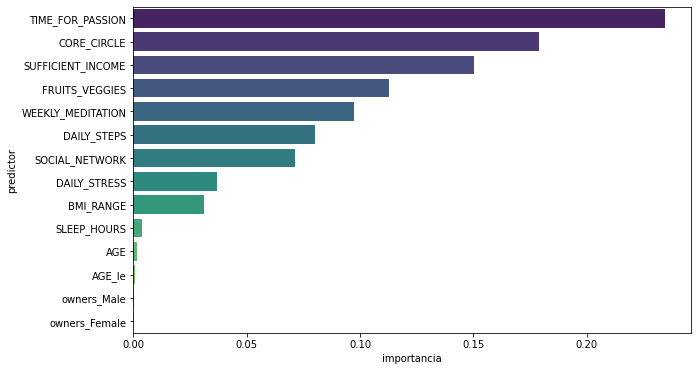

In [46]:
# por último ploteamos los resultados para verlo de una forma más amigable. 

plt.figure(figsize=(10,6))
sns.barplot(x = "importancia", y = "predictor", data = importancia_predictores, palette="viridis");
plt.show()

In [47]:
y_pred_test_rf = bosque.predict(x_test)
y_pred_train_rf = bosque.predict(x_train)

train_df12 = pd.DataFrame({'Real': y_train, 'Predicted': y_pred_train_rf, 'Set': ['Train']*len(y_train)})
test_df12  = pd.DataFrame({'Real': y_test,  'Predicted': y_pred_test_rf,  'Set': ['Test']*len(y_test)})
resultados = pd.concat([train_df12,test_df12], axis = 0)
resultados.head()

,Real,Predicted,Set
3271,25.930677,25.774042,Train
5715,25.752670,26.015796,Train
4074,27.325812,26.420572,Train
4447,26.166773,25.922511,Train
4298,25.579288,25.352471,Train


In [48]:
resultados['residuos'] = resultados['Real'] - resultados['Predicted']
resultados.head()

,Real,Predicted,Set,residuos
3271,25.930677,25.774042,Train,0.156635
5715,25.752670,26.015796,Train,-0.263127
4074,27.325812,26.420572,Train,0.905240
4447,26.166773,25.922511,Train,0.244262
4298,25.579288,25.352471,Train,0.226818


Los residuos pueden ser nulos, positivos o negativos:

- resíduos nulos => (valor observado de Y = valor estimado) => no existe ningún error en la estimación;

- resíduo positivo => (valor observado de Y > valor estimado) => se infraestima la variable Y;

- resíduo negativo => (valor observado de Y < valor estimado) => se sobreestima la variable Y.



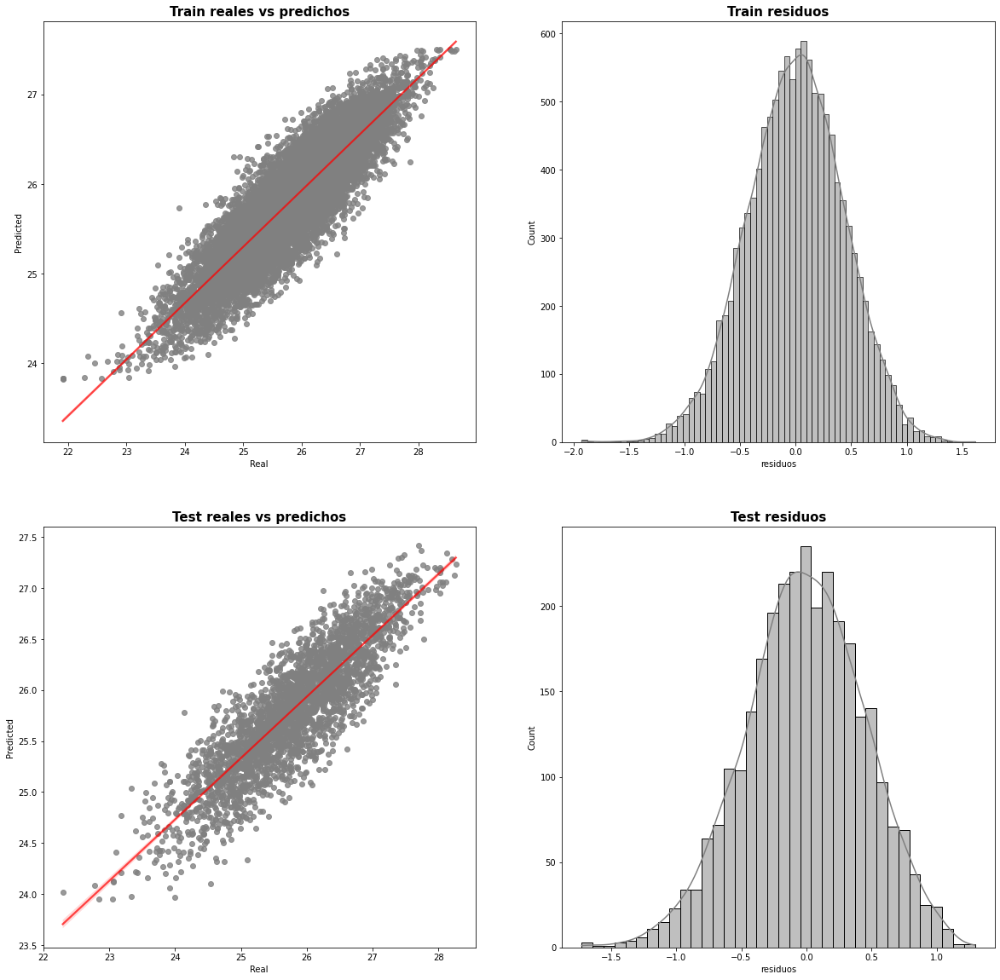

In [49]:
fig, ax = plt.subplots(2,2,figsize=(20,20))


# ploteamos los reales vs los predichos
sns.regplot(data = resultados[resultados['Set'] == "Train"], 
            x = "Real", 
            y = "Predicted", 
            ax = ax[0,0], 
            color = "grey",
            line_kws = {"color": "red", "alpha": 0.7 })


sns.regplot(data = resultados[resultados['Set'] == "Test"], 
            x = "Real",
            y = "Predicted", 
            color = "gray",
            line_kws = {"color": "red", "alpha": 0.7 }, 
            ax = ax[1,0])


# ploteamos los residuos
sns.histplot(resultados[resultados['Set'] == "Train"],
             x="residuos",
             color ="grey",
             kde=True, 
             ax = ax[0,1])


sns.histplot(resultados[resultados['Set'] == "Test"],
             x="residuos",
             color = "grey",
             kde=True, 
             ax = ax[1,1])

ax[0,0].set_title("Train reales vs predichos", fontsize = 15, fontweight = "bold")
ax[0,1].set_title("Train residuos", fontsize = 15, fontweight = "bold")
ax[1,0].set_title("Test reales vs predichos", fontsize = 15, fontweight = "bold")
ax[1,1].set_title("Test residuos", fontsize = 15, fontweight = "bold");